In [1]:
from __future__ import print_function,division
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib.image as mpimg
import glob

get_ipython().run_line_magic('matplotlib','inline')
plt.rcParams['figure.figsize'] = (10.0,8.0)
plt.rcParams['image.interpolation'] = 'nearest'
#plt.rcParams['image.cmap'] = 'gray'

In [2]:
def disp_images(images,type="color"):
    image_type = len(images.shape)
    images = np.reshape(images,[images.shape[0],-1])
    sqrtn = int(np.ceil(np.sqrt(images.shape[0])))
    if type=="color":   
        global sqrtimg
        sqrtimg = int(np.ceil(np.sqrt(images.shape[1]/3))) #--------------------------------------------------------        
    else:  
        print("error, need to revise")
    figure = plt.figure(figsize = (sqrtn,sqrtn))
    gs = gridspec.GridSpec(sqrtn,sqrtn)
    gs.update(wspace = 0.05,hspace = 0.05)
    for i,img in enumerate(images):
        ax = plt.subplot(gs[i])
        plt.axis('off')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_aspect('equal')
        plt.imshow(img.reshape([sqrtimg,sqrtimg,3]))

def preprocess(x):
    return 2*x-1.0
def deprocess(x):
    return (x+1.0) / 2.0
def count_params():
    param_count = np.sum([np.prod(x.get_shape().as_list()) for x in tf.global_variables()])
    return param_count
def session():
    config = tf.ConfigProto()
    config.gpu_options.allow_growth = True
    session = tf.Session(config = config)
    return session
def activation(x, alpha = 0.01):# leaky relu
    a = tf.maximum(x,alpha*x)
    return a
def sample_noise(batch_size,dim):
    random_noise = tf.random_uniform(maxval = 1,minval = -1,shape =[batch_size,dim])
    return random_noise

def get_solvers(lr = 1e-3, beta1 = 0.5):
    d_solver = tf.train.AdamOptimizer(learning_rate = lr,beta1 = beta1)
    g_solver = tf.train.AdamOptimizer(learning_rate = lr,beta1 = beta1)
    return d_solver,g_solver
def wgan_gp_loss(logits_real,logits_fake,batch_size,x,G_sample):
    d_loss = - tf.reduce_mean(logits_real) + tf.reduce_mean(logits_fake)
    g_loss = - tf.reduce_mean(logits_fake)
    lam = 10
    eps = tf.random_uniform([batch_size,1],minval=0.0,maxval=1.0)
    #a = tf.reshape(x,[batch_size,-1])    
    #b = tf.reshape(G_sample,[batch_size,-1])
    x_h = eps*x + (1-eps)*G_sample  #----------random relax search image-----------------------------------

    with tf.variable_scope("",reuse=True) as scope:# cannot understand gradient penalty
        #temp = tf.reshape(x_h,[batch_size,32,32,3])#-------------------------------------------change size
        grad_d_x_h = tf.gradients(discriminator(x_h),x_h)# [batch,32*32*3]
    grad_norm = tf.norm(grad_d_x_h[0],axis=1,ord='euclidean')#fetch x-gradient and apply euclidean calibration
    grad_pen = tf.reduce_mean(tf.square(grad_norm-1))
    
    d_loss += lam*grad_pen  #this is the key pivot at WGAN-GP
    tf.summary.scalar("d_loss",d_loss)
    tf.summary.scalar("g_loss",g_loss)
    return d_loss,g_loss


def wgan_loss(logits_real,logits_fake,batch_size,x,G_sample):  #not yet regularization
    d_loss = - tf.reduce_mean(logits_real) + tf.reduce_mean(logits_fake)
    g_loss = - tf.reduce_mean(logits_fake)
    tf.summary.scalar("d_loss",d_loss)
    tf.summary.scalar("g_loss",g_loss)
    return d_loss,g_loss

def dcgan_loss(logits_real,logits_fake,batch_size,x,G_sample): #not yet regularization
    d_loss = - tf.reduce_mean(tf.log(tf.clip_by_value(logits_real,1e-12,1.0)))-tf.reduce_mean(tf.log(tf.clip_by_value(1 - logits_fake,1e-12,1.0)))
    g_loss = - tf.reduce_mean(tf.log(tf.clip_by_value(logits_fake,1e-12,1.0)))
    tf.summary.scalar("d_loss",d_loss)
    tf.summary.scalar("g_loss",g_loss)
    return d_loss,g_loss
###################loss
def fetch_img(path,amount=5000):
    image_list = []
    count = 0
    for filename in glob.glob(path + '/*.jpg'): #assuming gif
        count += 1
        im=mpimg.imread(filename)
        image_list.append(im)
        if count%5000 == 0:
            print(str(count) + "/50000")
        if count == amount:
            break
    cifar_10 = np.array(image_list)
    cifar_10 = cifar_10 * 1.0 / 255        #calibration from [0,255] to [0.0~1.0]
    print(cifar_10.shape)
    disp_images(cifar_10[:save_size])
    return cifar_10

(100, 96, 96, 3)


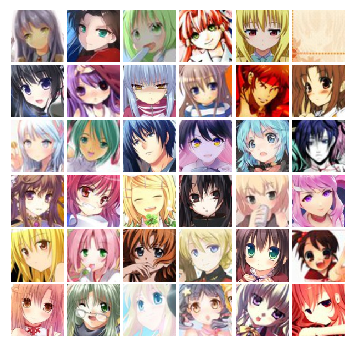

In [3]:
path = '/home/lw2435/faces'
fetch_amount = 100
batch_size = 36
noise_dim = 1024
log_dir='/home/lw2435' + '/DCGAN-vfinal'#------------------------------------------------------------------------
save_size = 36
cifar_10 = fetch_img(path,fetch_amount)

In [22]:
def attention(x,ch):
    with tf.variable_scope('attention', reuse=False):
        init = tf.contrib.layers.xavier_initializer()
        f = tf.layers.conv2d(x,filters=ch//8,kernel_size=1,strides=1,padding='same',  
                            kernel_initializer=init,name='ff_conv')
        g = tf.layers.conv2d(x,filters=ch//8,kernel_size=1,strides=1,padding='same',  
                            kernel_initializer=init,name='gg_conv')
        
        f = tf.reshape(f,shape=[f.shape[0],-1,f.shape[-1]])
        g = tf.reshape(g,shape=[g.shape[0],-1,g.shape[-1]])
        
        combine_f_g = tf.matmul(g,f,transpose_b=True)   #[batch,height,width,channel/2]
        combine_f_g = tf.nn.softmax(combine_f_g, dim=-1)#[batch,h*w,h*w]
        
        h = tf.layers.conv2d(x,filters=ch,kernel_size=1,strides=1,padding='same',  
                            kernel_initializer=init,name='hh_conv') #[batch,height,width,channel]
        h = tf.reshape(h,shape=[h.shape[0],-1,h.shape[-1]])      # [batch,h*w,channel]
        # N = h * w
        
        combine_f_g_h = tf.matmul(combine_f_g,h) # [batch,h*w,channel]
        combine_f_g_h = tf.reshape(combine_f_g_h, shape=x.shape)
        
        gamma = tf.get_variable("gamma",[1],initializer=tf.constant_initializer(0.0))
        x = gamma * combine_f_g_h + x

        return x
    
def generator(x):#for dcgan   input  [batch=128,noise_dim=1024]
    with tf.variable_scope("generator"):#zzz???????????????
        init = tf.contrib.layers.xavier_initializer()
        #reshape
        fc1 = tf.layers.dense(inputs=z,units=4*4*256,kernel_initializer=init,name='g_dense_0')  #[batch,4*4*256]#_--------------modify for all
        fc1 = tf.layers.batch_normalization(fc1,name='g_batchnorm_0')
        fc1 = tf.nn.relu(fc1)
        img = tf.reshape(fc1,[-1,4,4,256])                                              #[batch,4,4,256]   depth=256
        #deconv1
        img = tf.layers.conv2d_transpose(img,filters=128,kernel_size=4,strides=2,padding='same', #batch*8*8*128    strides=扩大几倍
                                                kernel_initializer=init,name='g_deconv_1')
        img = tf.layers.batch_normalization(img,name='g_batchnorm_1')
        img = tf.nn.relu(img)
 
        img = tf.layers.conv2d_transpose(img,filters=64,kernel_size=4,strides=2,padding='same', #batch*16*16*64
                                                kernel_initializer=init,name='g_deconv_2')
        img = tf.layers.batch_normalization(img,name='g_batchnorm_2')
        img = tf.nn.relu(img)
        
        #img = attention(img,64)
        
        img = tf.layers.conv2d_transpose(img,filters=16,kernel_size=4,strides=2,padding='same', #batch*32*32*16
                                                kernel_initializer=init,name='g_deconv_3')
        img = tf.layers.batch_normalization(img,name='g_batchnorm_3')
        img = tf.nn.relu(img)

        img = tf.layers.conv2d_transpose(img,filters=3,kernel_size=4,strides=2,padding='same', #batch*64*64*3 #-----------------------adding layer
                                                kernel_initializer=init,name='g_deconv_4')
        img = tf.layers.batch_normalization(img,name='g_batchnorm_4')
        img = tf.nn.tanh(img)  #size down is a linear function !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
        #img = tf.layers.conv2d_transpose(img,3,4,strides=1,padding='same', #batch*32*32*3-------------------------------------
                                                #activation=tf.nn.tanh,kernel_initializer=init,name='g_deconv_4')#-------activation

        #img = tf.layers.batch_normalization(img,name='g_batchnorm_3')
        #img = tf.nn.relu(img)
        #reshape
        img = tf.reshape(img,[-1,64*64*3]) #[batch,] #------------------------------change size
        
        img = tf.layers.dense(inputs=img,units=img_size*img_size*3,kernel_initializer=init,name='g_dense_5') #----------adding layer
        #img = tf.nn.tanh(img)
        
        a = tf.abs(tf.reduce_min(img,axis=1))
        b = tf.abs(tf.reduce_max(img,axis=1))
        c = tf.maximum(a,b)
        img = tf.transpose(tf.divide(tf.transpose(img) ,c))
        
        print(img.get_shape)
        #img = tf.layers.dense(inputs=img,units=,activation=tf.nn.tanh,name='tanh')#---------------change para   #change output size
        #img = tf.image.resize_images(img,(img_size,img_size),method=0)
        img = tf.reshape(img,shape=[-1,img_size*img_size*3])

        return img

def train(sess,G_train_step,G_loss,D_train_step,D_loss,G_extra_step,D_extra_step,
         show_every=250,print_every=50,batch_size=128,num_epoch=10):
    max_iter = int(cifar_10.shape[0]*num_epoch/batch_size)#===========================================
    offset = 0 #============================================================
    epoch_cur = 0
    for it in range(max_iter):
        if (it % show_every == 0):
            #print(sess.run(tf.reduce_max(G_sample)))
            #print(sess.run(tf.reduce_min(G_sample)))
            samples = deprocess(sess.run(G_sample))#-----------------------------take care to deprocess samples!!!
            fig = disp_images(samples[:64])# one global para
            plt.show()
            print()
        #fetch the minibatch and train
        #minibatch,minibatch_y = mnist.train.next_batch(batch_size)
        minibatch1 = cifar_10[offset : offset + batch_size]
        #offset = offset + batch_size
        if (offset + batch_size >= cifar_10.shape[0]):    
            epoch_cur = epoch_cur + 1
            print("epoch:"+str(epoch_cur)+"---------------------------------")
            np.random.shuffle(cifar_10)
            offset = 0
        minibatch1 = minibatch1.reshape(minibatch1.shape[0],-1)# serialize all the pixels

        _,D_loss_curr = sess.run([D_train_step,D_loss],feed_dict = {x:minibatch1})
        _,G_loss_curr = sess.run([G_train_step,G_loss])
        #fetch the minibatch and train
        
        if (it % print_every == 0):
            print('Iter:{}, D:{:.4}, G:{:.4}'.format(it,D_loss_curr,G_loss_curr))
        if (it % show_every == 0):      
            rs = sess.run(merged,feed_dict = {x:minibatch1})#-------------------------------------------
            train_writer.add_summary(rs,it)
    print('Final images')
    samples = deprocess(sess.run(G_sample))
        
    fig = disp_images(samples[:save_size])# one global para
    plt.show()
  
def discriminator(x):#for wgan    input  [batch,32*32*3]
    with tf.variable_scope('discriminator'):
        init = tf.contrib.layers.xavier_initializer()
        
        x = tf.reshape(x,[-1,img_size*img_size*3])  #----------------------------------------change para:   [batch,96*96*3]
        #x = tf.reshape(x,[-1,img_size,img_size,3])  #generalize serialized pixels and bunch of pixels
        #x = tf.image.resize_images(x,(64,64),method=0)   #[batch,64,64,3]
        x = tf.layers.dense(x,3072,kernel_initializer=init,name='d_dense_0')#------we can never add batch normalization there
                                                                                #!!!!!!!!!!for down sample
        x = activation(x)
        
        x = tf.reshape(x,[-1,32,32,3])# one global para
        
        x = tf.layers.conv2d(x,64,4,strides=2,padding='same',  #batch*16*16*64
                            kernel_initializer=init,name='d_conv_1')
        x = tf.layers.batch_normalization(x,name='d_batchnorm_1')
        x = activation(x)        

        #x = attention(x,64)
        
        x = tf.layers.conv2d(x,128,4,strides=2,padding='same',  #batch*8*8*64
                            kernel_initializer=init,name='d_conv_2')
        x = tf.layers.batch_normalization(x,name='d_batchnorm_2')
        x = activation(x)      
        
        x = tf.reshape(x,[-1,8*8*128])                              # [batch,(8*8*128)]
        #x = tf.layers.dense(x,1024,kernel_initializer=init,name='d_dense3')  #discriminator too strong
        logits = tf.layers.dense(x,1,kernel_initializer=init,name='logits')
        #logits = tf.nn.sigmoid(logits)
        return logits



<bound method Tensor.get_shape of <tf.Tensor 'generator/transpose_1:0' shape=(36, 27648) dtype=float32>>


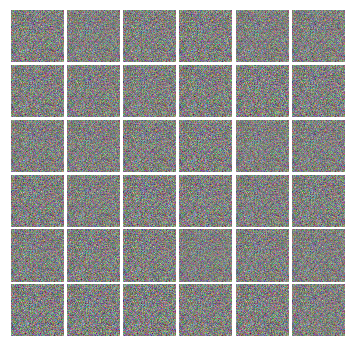


Iter:0, D:7.269, G:4.281
Iter:5, D:31.5, G:-3.884
Iter:10, D:-86.32, G:-46.02
Iter:15, D:-434.7, G:-14.32
Iter:20, D:659.3, G:47.5
Iter:25, D:-25.64, G:36.36
Iter:30, D:0.323, G:-57.8
Iter:35, D:-4.585, G:10.66
Iter:40, D:-42.51, G:-29.97
Iter:45, D:-37.77, G:24.15
Iter:50, D:-75.56, G:3.413
Iter:55, D:-132.8, G:-55.89
Iter:60, D:-162.0, G:-41.52
Iter:65, D:96.95, G:-129.9
Iter:70, D:-109.2, G:85.72
Iter:75, D:-154.2, G:100.2
Iter:80, D:-138.2, G:29.57
Iter:85, D:-149.2, G:-2.003
Iter:90, D:-170.2, G:-23.61
Iter:95, D:-226.4, G:-46.79
Iter:100, D:-292.5, G:-31.95
Iter:105, D:-284.8, G:-2.162
Iter:110, D:-198.0, G:-2.438
Iter:115, D:-94.63, G:17.87
Iter:120, D:-312.6, G:33.21
Iter:125, D:-374.9, G:3.132
Iter:130, D:-471.3, G:-8.9
Iter:135, D:-461.9, G:-21.11
Iter:140, D:-563.1, G:-15.65
Iter:145, D:-399.6, G:-69.33
Iter:150, D:-719.9, G:-4.613
Iter:155, D:400.8, G:13.43
Iter:160, D:-878.6, G:-50.65
Iter:165, D:-557.8, G:36.83
Iter:170, D:-694.6, G:-55.6
Iter:175, D:-727.1, G:-39.3
Iter

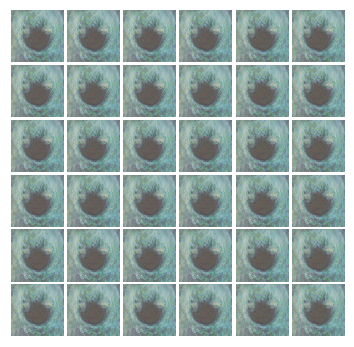


Iter:200, D:-607.9, G:38.34
Iter:205, D:-573.6, G:28.21
Iter:210, D:-1.209e+03, G:0.4725
Iter:215, D:-875.6, G:31.09
Iter:220, D:-714.0, G:-45.31
Iter:225, D:-949.7, G:-45.85
Iter:230, D:-850.1, G:6.132
Iter:235, D:-1.075e+03, G:-28.71
Iter:240, D:-1.381e+03, G:15.69
Iter:245, D:-883.6, G:2.942
Iter:250, D:-1.025e+03, G:0.1794
Iter:255, D:-1.129e+03, G:-30.91
Iter:260, D:31.97, G:-14.26
Iter:265, D:-749.3, G:28.92
Iter:270, D:-936.4, G:-9.882
Iter:275, D:-891.4, G:-11.54
Iter:280, D:-855.1, G:-25.53
Iter:285, D:-1.079e+03, G:-14.02
Iter:290, D:-1.261e+03, G:-27.42
Iter:295, D:-1.07e+03, G:50.4
Iter:300, D:-295.7, G:-40.71
Iter:305, D:-563.5, G:38.73
Iter:310, D:-592.6, G:11.93
Iter:315, D:-759.1, G:4.895
Iter:320, D:-739.0, G:21.88
Iter:325, D:-536.8, G:20.82
Iter:330, D:-725.8, G:-10.88
Iter:335, D:-635.9, G:-14.57
Iter:340, D:-672.3, G:18.01
Iter:345, D:-623.9, G:-6.204
Iter:350, D:-624.0, G:-27.69
Iter:355, D:-590.4, G:1.608
Iter:360, D:-650.5, G:7.069
Iter:365, D:-559.5, G:25.47
I

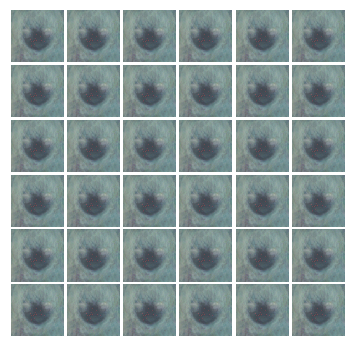


Iter:400, D:-455.1, G:-0.1588
Iter:405, D:-604.7, G:14.0
Iter:410, D:-553.4, G:4.503
Iter:415, D:-440.9, G:21.13
Iter:420, D:-569.3, G:5.66
Iter:425, D:-469.7, G:8.758
Iter:430, D:-528.4, G:26.61
Iter:435, D:-484.4, G:18.8
Iter:440, D:-591.1, G:8.372
Iter:445, D:-658.0, G:-0.9643
Iter:450, D:-525.2, G:-5.592
Iter:455, D:-558.3, G:22.95
Iter:460, D:-625.1, G:-8.896
Iter:465, D:-500.1, G:18.09
Iter:470, D:-549.5, G:-27.73
Iter:475, D:-538.2, G:41.89
Iter:480, D:-401.0, G:-16.55
Iter:485, D:-509.4, G:38.62
Iter:490, D:-514.3, G:40.06
Iter:495, D:-471.9, G:24.27
Iter:500, D:-387.0, G:21.75
Iter:505, D:-446.0, G:-6.413
Iter:510, D:-403.2, G:12.61
Iter:515, D:-522.3, G:-16.34
Iter:520, D:-428.5, G:15.48
Iter:525, D:-466.7, G:30.92
Iter:530, D:-429.4, G:20.21
Iter:535, D:-473.6, G:5.027
Iter:540, D:-442.4, G:49.87
Iter:545, D:-392.7, G:22.98
Iter:550, D:-430.2, G:18.78
Iter:555, D:-391.8, G:12.53
Iter:560, D:-433.5, G:0.6663
Iter:565, D:-411.8, G:13.89
Iter:570, D:-432.6, G:-5.743
Iter:575, 

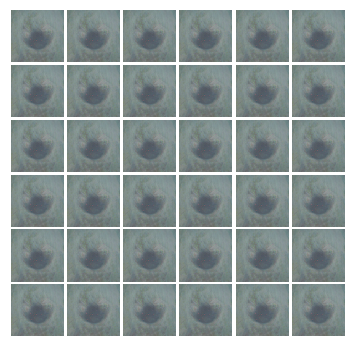


Iter:600, D:-413.5, G:-16.87
Iter:605, D:-446.9, G:0.409
Iter:610, D:-415.3, G:4.913
Iter:615, D:-431.2, G:10.04
Iter:620, D:-388.4, G:-0.283
Iter:625, D:-368.1, G:25.91
Iter:630, D:-345.7, G:19.36
Iter:635, D:-442.3, G:1.442
Iter:640, D:-508.6, G:25.32
Iter:645, D:-465.2, G:-0.2588
Iter:650, D:-430.0, G:-0.05482
Iter:655, D:-442.9, G:-3.354
Iter:660, D:-450.4, G:9.763
Iter:665, D:-438.4, G:17.48
Iter:670, D:-336.6, G:5.647
Iter:675, D:-452.6, G:-2.391
Iter:680, D:-444.3, G:3.331
Iter:685, D:-443.4, G:-6.379
Iter:690, D:-438.2, G:21.97
Iter:695, D:-497.6, G:12.91
Iter:700, D:-436.1, G:27.33
Iter:705, D:-486.1, G:2.471
Iter:710, D:-462.1, G:20.52
Iter:715, D:-483.5, G:-2.042
Iter:720, D:-401.0, G:3.247
Iter:725, D:-389.3, G:12.82
Iter:730, D:-433.5, G:23.98
Iter:735, D:-484.8, G:13.04
Iter:740, D:-485.6, G:21.41
Iter:745, D:-416.0, G:22.39
Iter:750, D:-418.0, G:25.85
Iter:755, D:-394.5, G:20.54
Iter:760, D:-468.8, G:16.73
Iter:765, D:-473.2, G:15.38
Iter:770, D:-280.9, G:19.94
Iter:775

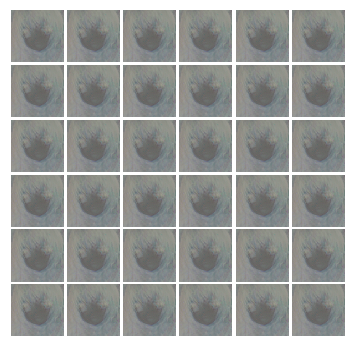


Iter:800, D:-472.3, G:8.12
Iter:805, D:-376.8, G:20.88
Iter:810, D:-452.9, G:42.24
Iter:815, D:-86.75, G:7.964
Iter:820, D:-436.5, G:24.46
Iter:825, D:-433.6, G:-29.78
Iter:830, D:-407.7, G:11.1
Iter:835, D:-395.7, G:20.72
Iter:840, D:-413.9, G:12.47
Iter:845, D:-485.3, G:-7.131
Iter:850, D:-445.6, G:27.43
Iter:855, D:-474.9, G:32.35
Iter:860, D:-464.0, G:3.063
Iter:865, D:-508.7, G:3.661
Iter:870, D:-483.9, G:2.451
Iter:875, D:-432.4, G:7.305
Iter:880, D:-365.9, G:4.873
Iter:885, D:-445.0, G:-12.49
Iter:890, D:-474.2, G:31.54
Iter:895, D:-480.0, G:14.36
Iter:900, D:-502.2, G:-18.09
Iter:905, D:-454.0, G:-2.46
Iter:910, D:-425.5, G:13.9
Iter:915, D:-445.9, G:11.79
Iter:920, D:-400.2, G:-0.03391
Iter:925, D:40.37, G:-11.74
Iter:930, D:-233.7, G:-33.67
Iter:935, D:-251.9, G:30.84
Iter:940, D:2.01e+03, G:-107.8
Iter:945, D:-202.2, G:-13.07
Iter:950, D:-211.2, G:-27.61
Iter:955, D:-245.2, G:-46.54
Iter:960, D:-293.6, G:-40.45
Iter:965, D:-275.8, G:68.79
Iter:970, D:-314.9, G:-56.6
Iter:97

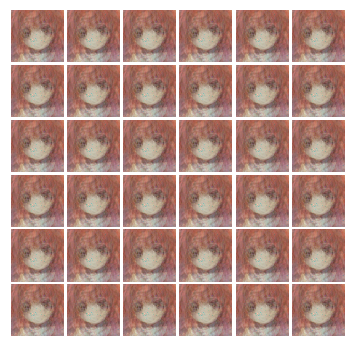


Iter:1000, D:-242.8, G:-102.4
Iter:1005, D:-315.7, G:23.74
Iter:1010, D:-258.8, G:14.13
Iter:1015, D:-336.8, G:-49.85
Iter:1020, D:-315.6, G:-52.63
Iter:1025, D:-379.8, G:0.3716
Iter:1030, D:-316.8, G:3.765
Iter:1035, D:-365.2, G:-14.29
Iter:1040, D:-372.8, G:39.11
Iter:1045, D:-375.4, G:-51.35
Iter:1050, D:-390.5, G:118.2
Iter:1055, D:-385.5, G:97.62
Iter:1060, D:-436.9, G:-6.42
Iter:1065, D:-355.9, G:138.4
Iter:1070, D:-428.3, G:121.3
Iter:1075, D:-401.2, G:-4.612
Iter:1080, D:-365.5, G:59.07
Iter:1085, D:-408.9, G:1.5
Iter:1090, D:-375.0, G:-15.99
Iter:1095, D:-381.0, G:-20.44
Iter:1100, D:-403.0, G:-35.15
Iter:1105, D:-428.4, G:35.3
Iter:1110, D:-386.3, G:-67.22
Iter:1115, D:-408.2, G:82.18
Iter:1120, D:-368.8, G:-77.57
Iter:1125, D:-387.1, G:167.1
Iter:1130, D:-404.2, G:-17.19
Iter:1135, D:-315.6, G:142.3
Iter:1140, D:-356.7, G:1.335
Iter:1145, D:-288.2, G:-11.12
Iter:1150, D:-345.4, G:-13.29
Iter:1155, D:-342.6, G:-32.87
Iter:1160, D:-399.7, G:-2.848
Iter:1165, D:-365.8, G:46.21

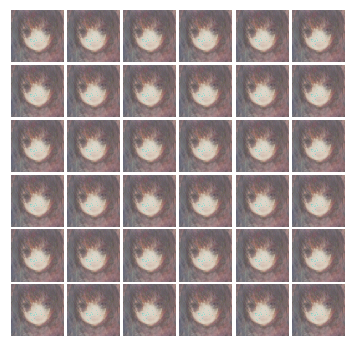


Iter:1200, D:-270.2, G:114.7
Iter:1205, D:63.75, G:-103.4
Iter:1210, D:-408.7, G:71.62
Iter:1215, D:-413.9, G:37.99
Iter:1220, D:-400.7, G:28.13
Iter:1225, D:-386.0, G:-34.56
Iter:1230, D:-404.5, G:3.466
Iter:1235, D:-400.8, G:-76.91
Iter:1240, D:-434.9, G:72.95
Iter:1245, D:-501.3, G:7.133
Iter:1250, D:-491.7, G:78.09
Iter:1255, D:-359.4, G:-99.83
Iter:1260, D:-412.4, G:93.41
Iter:1265, D:-478.1, G:103.9
Iter:1270, D:-432.3, G:43.79
Iter:1275, D:-368.1, G:63.17
Iter:1280, D:-196.3, G:-105.2
Iter:1285, D:-424.8, G:60.6
Iter:1290, D:-356.9, G:-0.8898
Iter:1295, D:-362.8, G:29.12
Iter:1300, D:-400.5, G:-41.21
Iter:1305, D:-284.3, G:117.4
Iter:1310, D:-411.3, G:-55.67
Iter:1315, D:-424.7, G:-58.16
Iter:1320, D:-449.2, G:37.95
Iter:1325, D:-489.0, G:40.49
Iter:1330, D:-380.6, G:-11.81
Iter:1335, D:-50.31, G:-105.4
Iter:1340, D:-342.3, G:102.5
Iter:1345, D:-364.5, G:69.71
Iter:1350, D:-376.3, G:-6.32
Iter:1355, D:-376.7, G:23.25
Iter:1360, D:-421.5, G:-2.443
Iter:1365, D:-286.0, G:47.18
It

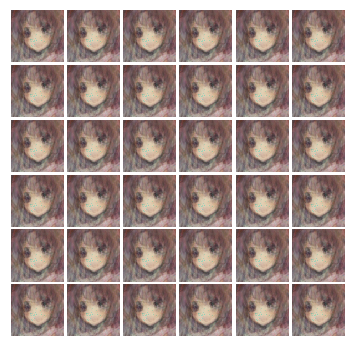


Iter:1400, D:-509.4, G:-1.428
Iter:1405, D:-438.0, G:73.82
Iter:1410, D:-354.9, G:-21.67
Iter:1415, D:-383.1, G:55.39
Iter:1420, D:-372.7, G:32.07
Iter:1425, D:-393.4, G:-8.67
Iter:1430, D:-432.5, G:13.87
Iter:1435, D:-393.9, G:-15.19
Iter:1440, D:-327.2, G:-25.99
Iter:1445, D:-371.7, G:-6.79
Iter:1450, D:-443.9, G:40.48
Iter:1455, D:-399.8, G:7.071
Iter:1460, D:-429.1, G:-8.595
Iter:1465, D:-419.3, G:-0.1636
Iter:1470, D:-457.9, G:1.476
Iter:1475, D:-429.4, G:-61.69
Iter:1480, D:-384.7, G:6.945
Iter:1485, D:-400.2, G:-67.96
Iter:1490, D:-399.1, G:89.59
Iter:1495, D:-312.7, G:-239.4
Iter:1500, D:-409.2, G:-88.89
Iter:1505, D:-442.7, G:15.28
Iter:1510, D:-490.0, G:75.17
Iter:1515, D:-516.8, G:36.55
Iter:1520, D:-501.2, G:31.59
Iter:1525, D:-255.8, G:-11.78
Iter:1530, D:-369.7, G:0.9809
Iter:1535, D:-380.3, G:23.74
Iter:1540, D:-422.9, G:8.019
Iter:1545, D:-388.9, G:-15.15
Iter:1550, D:-405.1, G:-15.99
Iter:1555, D:-433.3, G:12.23
Iter:1560, D:-426.8, G:-19.16
Iter:1565, D:-434.2, G:13.

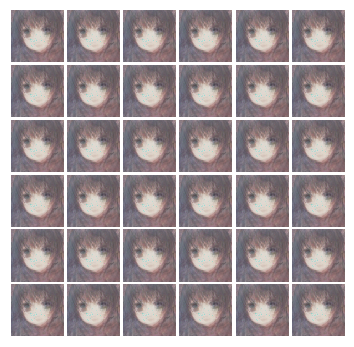


Iter:1600, D:-159.2, G:170.0
Iter:1605, D:-541.0, G:76.82
Iter:1610, D:-551.8, G:-37.6
Iter:1615, D:-552.6, G:5.858
Iter:1620, D:-595.9, G:-65.56
Iter:1625, D:-617.6, G:75.41
Iter:1630, D:-137.3, G:-52.21
Iter:1635, D:-452.0, G:65.9
Iter:1640, D:-452.1, G:82.96
Iter:1645, D:-410.8, G:50.82
Iter:1650, D:-452.1, G:8.469
Iter:1655, D:-445.4, G:-10.93
Iter:1660, D:-435.5, G:26.62
Iter:1665, D:-501.6, G:10.89
Iter:1670, D:-527.1, G:-24.92
Iter:1675, D:-543.7, G:8.389
Iter:1680, D:-379.9, G:-100.3
Iter:1685, D:937.2, G:-52.11
Iter:1690, D:-361.9, G:-14.52
Iter:1695, D:-406.8, G:25.41
Iter:1700, D:-416.0, G:-7.391
Iter:1705, D:-396.8, G:-6.828
Iter:1710, D:-452.4, G:5.128
Iter:1715, D:-424.3, G:-29.79
Iter:1720, D:-363.6, G:19.3
Iter:1725, D:-390.9, G:-6.15
Iter:1730, D:-455.3, G:13.59
Iter:1735, D:-415.0, G:-17.75
Iter:1740, D:-383.7, G:-38.72
Iter:1745, D:-388.4, G:-39.79
Iter:1750, D:-327.5, G:-21.37
Iter:1755, D:-463.5, G:46.83
Iter:1760, D:-507.4, G:46.48
Iter:1765, D:-495.1, G:-32.23
I

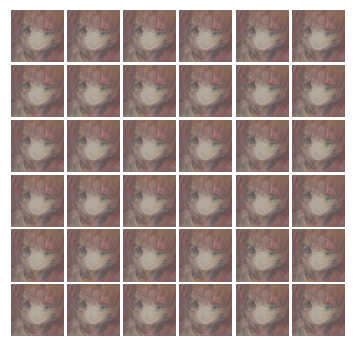


Iter:1800, D:-418.5, G:7.103
Iter:1805, D:-435.6, G:34.43
Iter:1810, D:-430.2, G:-33.03
Iter:1815, D:-476.0, G:14.34
Iter:1820, D:-483.7, G:-27.52
Iter:1825, D:-450.6, G:5.96
Iter:1830, D:-437.8, G:-30.08
Iter:1835, D:-382.5, G:-2.95
Iter:1840, D:-387.3, G:-14.91
Iter:1845, D:-473.2, G:46.39
Iter:1850, D:-409.2, G:-10.1
Iter:1855, D:-424.3, G:-0.1597
Iter:1860, D:-335.2, G:-8.75
Iter:1865, D:-391.8, G:-2.788
Iter:1870, D:-397.5, G:6.612
Iter:1875, D:-444.7, G:11.83
Iter:1880, D:-477.7, G:30.92
Iter:1885, D:-453.3, G:10.92
Iter:1890, D:-476.1, G:7.325
Iter:1895, D:-448.1, G:-33.81
Iter:1900, D:-472.6, G:39.15
Iter:1905, D:-478.9, G:-51.87
Iter:1910, D:-510.7, G:-25.51
Iter:1915, D:-417.4, G:-24.05
Iter:1920, D:-303.5, G:-8.607
Iter:1925, D:-381.0, G:23.66
Iter:1930, D:-407.7, G:31.33
Iter:1935, D:-451.4, G:8.752
Iter:1940, D:-453.5, G:-20.7
Iter:1945, D:-465.4, G:1.44
Iter:1950, D:-505.0, G:-29.62
Iter:1955, D:-452.1, G:-81.39
Iter:1960, D:-454.2, G:39.22
Iter:1965, D:-478.5, G:-3.28
I

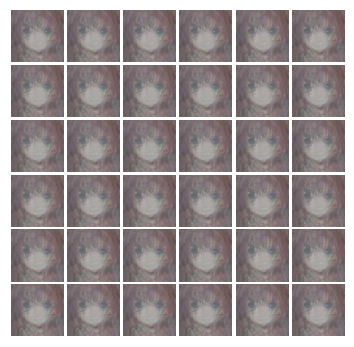


Iter:2000, D:-458.9, G:-25.02
Iter:2005, D:-439.2, G:-17.43
Iter:2010, D:-479.0, G:63.93
Iter:2015, D:-420.7, G:8.623
Iter:2020, D:-446.6, G:29.03
Iter:2025, D:-396.0, G:9.311
Iter:2030, D:-416.3, G:-0.8876
Iter:2035, D:-417.2, G:-20.32
Iter:2040, D:-445.4, G:0.7501
Iter:2045, D:-446.4, G:-45.94
Iter:2050, D:-489.0, G:32.21
Iter:2055, D:-416.9, G:-90.65
Iter:2060, D:-590.9, G:-50.32
Iter:2065, D:-572.3, G:51.04
Iter:2070, D:-513.9, G:-132.6
Iter:2075, D:-446.6, G:9.443
Iter:2080, D:43.77, G:-127.2
Iter:2085, D:-437.8, G:-14.28
Iter:2090, D:-499.1, G:8.854
Iter:2095, D:-494.2, G:29.04
Iter:2100, D:-467.3, G:-22.7
Iter:2105, D:-491.6, G:29.89
Iter:2110, D:-522.0, G:-24.11
Iter:2115, D:-452.3, G:-2.77
Iter:2120, D:-462.4, G:6.508
Iter:2125, D:-482.8, G:13.86
Iter:2130, D:-494.2, G:42.17
Iter:2135, D:-458.6, G:65.51
Iter:2140, D:-424.4, G:28.21
Iter:2145, D:-431.7, G:41.13
Iter:2150, D:-450.9, G:26.25
Iter:2155, D:-442.7, G:34.08
Iter:2160, D:-432.9, G:27.4
Iter:2165, D:-435.9, G:11.04
It

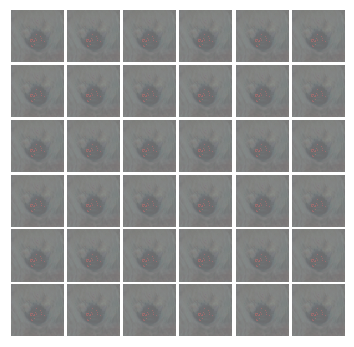


Iter:2200, D:-507.2, G:-16.8
Iter:2205, D:-560.9, G:-3.371
Iter:2210, D:-543.9, G:-13.69
Iter:2215, D:-599.5, G:-18.39
Iter:2220, D:848.2, G:-2.816
Iter:2225, D:-319.2, G:-20.21
Iter:2230, D:-363.6, G:-40.28
Iter:2235, D:-295.0, G:-55.47
Iter:2240, D:-355.5, G:-67.85
Iter:2245, D:-419.2, G:-23.15
Iter:2250, D:-374.2, G:-13.27
Iter:2255, D:-446.0, G:-33.44
Iter:2260, D:-456.4, G:23.56
Iter:2265, D:-449.8, G:0.9278
Iter:2270, D:-420.8, G:34.63
Iter:2275, D:-412.6, G:-16.23
Iter:2280, D:-465.9, G:9.568
Iter:2285, D:-406.3, G:17.49
Iter:2290, D:-447.8, G:-17.57
Iter:2295, D:-435.4, G:0.2762
Iter:2300, D:-445.2, G:38.35
Iter:2305, D:-420.0, G:-12.14
Iter:2310, D:-431.8, G:-8.109
Iter:2315, D:-425.8, G:33.71
Iter:2320, D:-470.7, G:-44.25
Iter:2325, D:-464.9, G:-16.91
Iter:2330, D:-462.5, G:-43.21
Iter:2335, D:-341.2, G:-41.63
Iter:2340, D:-460.3, G:49.35
Iter:2345, D:-472.1, G:11.3
Iter:2350, D:-464.7, G:42.67
Iter:2355, D:-357.6, G:-47.6
Iter:2360, D:-423.0, G:-60.87
Iter:2365, D:-440.3, G

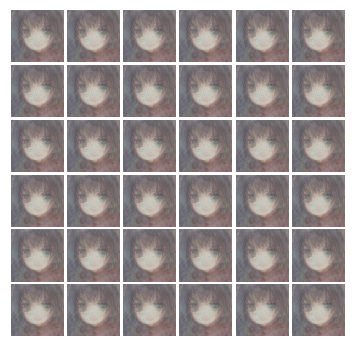


Iter:2400, D:-454.4, G:-58.13
Iter:2405, D:-195.4, G:-131.2
Iter:2410, D:-412.5, G:-71.09
Iter:2415, D:-473.9, G:-33.17
Iter:2420, D:-470.1, G:-32.54
Iter:2425, D:-478.9, G:-22.16
Iter:2430, D:-512.5, G:10.54
Iter:2435, D:-452.4, G:39.16
Iter:2440, D:-402.8, G:-23.28
Iter:2445, D:-466.6, G:-18.15
Iter:2450, D:-478.1, G:-29.29
Iter:2455, D:-470.4, G:35.62
Iter:2460, D:-496.1, G:-11.71
Iter:2465, D:-494.9, G:21.63
Iter:2470, D:-539.0, G:36.71
Iter:2475, D:-467.9, G:-96.37
Iter:2480, D:-507.6, G:-52.57
Iter:2485, D:-588.4, G:41.91
Iter:2490, D:-597.7, G:-4.568
Iter:2495, D:-595.3, G:2.109
Iter:2500, D:168.9, G:-106.2
Iter:2505, D:-384.2, G:-36.18
Iter:2510, D:-436.7, G:19.85
Iter:2515, D:-440.1, G:38.65
Iter:2520, D:-484.0, G:36.21
Iter:2525, D:-469.0, G:6.813
Iter:2530, D:-386.5, G:-9.867
Iter:2535, D:-403.1, G:-37.25
Iter:2540, D:-429.0, G:-13.99
Iter:2545, D:-448.9, G:-14.16
Iter:2550, D:-478.3, G:14.67
Iter:2555, D:-475.7, G:16.2
Iter:2560, D:-472.9, G:-17.69
Iter:2565, D:-409.4, G:1

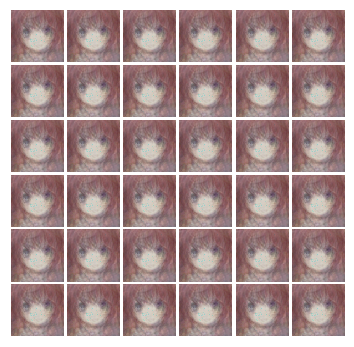


Iter:2600, D:-113.7, G:23.69
Iter:2605, D:-469.6, G:-39.99
Iter:2610, D:-515.1, G:42.81
Iter:2615, D:-478.5, G:-108.2
Iter:2620, D:-537.8, G:31.61
Iter:2625, D:-429.8, G:-114.4
Iter:2630, D:-267.5, G:83.83
Iter:2635, D:-244.5, G:20.69
Iter:2640, D:-452.9, G:31.55
Iter:2645, D:-458.8, G:31.18
Iter:2650, D:-423.1, G:22.06
Iter:2655, D:-419.0, G:-16.84
Iter:2660, D:-449.5, G:-20.62
Iter:2665, D:-452.4, G:-47.97
Iter:2670, D:-444.7, G:-50.42
Iter:2675, D:-369.8, G:50.93
Iter:2680, D:-459.0, G:-69.29
Iter:2685, D:-490.3, G:0.5148
Iter:2690, D:-523.8, G:-26.44
Iter:2695, D:-463.3, G:-35.81
Iter:2700, D:-460.3, G:-3.442
Iter:2705, D:-350.9, G:-10.15
Iter:2710, D:-453.8, G:26.83
Iter:2715, D:-410.0, G:-0.7709
Iter:2720, D:-384.9, G:-88.34
Iter:2725, D:-412.4, G:-27.32
Iter:2730, D:-459.6, G:-17.37
Iter:2735, D:-476.7, G:-6.204
Iter:2740, D:-509.3, G:-30.79
Iter:2745, D:-539.5, G:-92.16
Iter:2750, D:-501.2, G:45.75
Iter:2755, D:-576.5, G:-27.42
Iter:2760, D:-209.5, G:53.01
Iter:2765, D:-183.0,

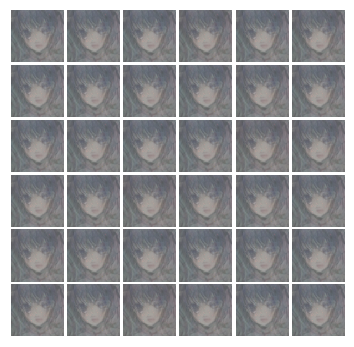


Iter:2800, D:-526.6, G:-8.251
Iter:2805, D:-507.3, G:-2.921
Iter:2810, D:-470.3, G:-19.38
Iter:2815, D:-448.0, G:-33.81
Iter:2820, D:-299.5, G:-56.21
Iter:2825, D:-447.4, G:30.73
Iter:2830, D:-427.6, G:21.78
Iter:2835, D:-428.6, G:8.089
Iter:2840, D:-440.9, G:-26.13
Iter:2845, D:-422.0, G:-12.36
Iter:2850, D:-433.1, G:-18.26
Iter:2855, D:-466.1, G:-30.2
Iter:2860, D:-429.6, G:-18.77
Iter:2865, D:-484.0, G:-54.8
Iter:2870, D:-461.4, G:-45.86
Iter:2875, D:-480.1, G:-27.26
Iter:2880, D:-500.7, G:-34.15
Iter:2885, D:-451.5, G:-56.27
Iter:2890, D:-386.7, G:-38.63
Iter:2895, D:-441.9, G:11.83
Iter:2900, D:-460.4, G:-8.656
Iter:2905, D:-466.3, G:10.23
Iter:2910, D:-473.3, G:-32.5
Iter:2915, D:-446.6, G:-21.74
Iter:2920, D:-334.5, G:-34.57
Iter:2925, D:-406.5, G:-22.69
Iter:2930, D:-412.3, G:-33.53
Iter:2935, D:-458.7, G:-17.65
Iter:2940, D:-467.4, G:9.55
Iter:2945, D:-483.9, G:0.8115
Iter:2950, D:-517.7, G:-65.79
Iter:2955, D:-539.0, G:-97.9
Iter:2960, D:-583.5, G:-17.65
Iter:2965, D:-544.7,

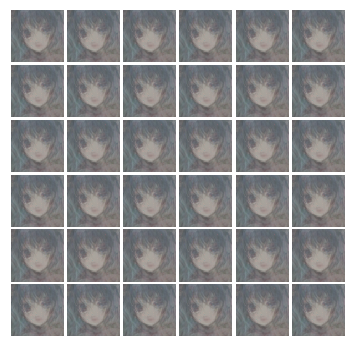


Iter:3000, D:-444.5, G:-0.02823
Iter:3005, D:-409.0, G:-34.14
Iter:3010, D:-377.9, G:-5.141
Iter:3015, D:-412.7, G:-47.24
Iter:3020, D:-459.4, G:-29.61
Iter:3025, D:-428.9, G:-51.13
Iter:3030, D:-462.5, G:25.24
Iter:3035, D:-138.7, G:-125.9
Iter:3040, D:-417.8, G:-8.005
Iter:3045, D:-454.7, G:52.34
Iter:3050, D:-434.9, G:19.02
Iter:3055, D:-433.5, G:-55.21
Iter:3060, D:-436.9, G:-16.21
Iter:3065, D:-478.5, G:-52.95
Iter:3070, D:-424.8, G:-168.5
Iter:3075, D:-471.3, G:-20.85
Iter:3080, D:-476.7, G:-40.5
Iter:3085, D:-381.4, G:-32.02
Iter:3090, D:-480.3, G:34.06
Iter:3095, D:-448.9, G:-7.137
Iter:3100, D:-448.1, G:10.1
Iter:3105, D:-374.7, G:-39.01
Iter:3110, D:-347.6, G:-55.22
Iter:3115, D:-411.2, G:-38.15
Iter:3120, D:-425.3, G:19.81
Iter:3125, D:-461.8, G:-1.222
Iter:3130, D:-456.5, G:-74.19
Iter:3135, D:-430.3, G:9.092
Iter:3140, D:-467.9, G:-90.28
Iter:3145, D:-476.4, G:10.78
Iter:3150, D:-562.6, G:-40.26
Iter:3155, D:-470.4, G:-82.28
Iter:3160, D:-488.1, G:1.876
Iter:3165, D:-447.

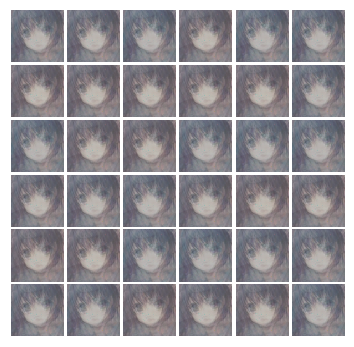


Iter:3200, D:-432.0, G:-25.35
Iter:3205, D:-455.9, G:-87.85
Iter:3210, D:-393.5, G:-15.58
Iter:3215, D:-524.9, G:-80.45
Iter:3220, D:-236.7, G:-76.13
Iter:3225, D:-479.6, G:41.3
Iter:3230, D:-443.0, G:4.224
Iter:3235, D:-373.6, G:-30.03
Iter:3240, D:-320.0, G:-17.45
Iter:3245, D:-403.3, G:-75.61
Iter:3250, D:-449.0, G:-83.23
Iter:3255, D:56.26, G:350.3
Iter:3260, D:-157.9, G:-67.34
Iter:3265, D:-310.0, G:-37.93
Iter:3270, D:-50.6, G:-75.28
Iter:3275, D:-439.7, G:-7.77
Iter:3280, D:-490.5, G:-37.05
Iter:3285, D:-451.9, G:-67.07
Iter:3290, D:-558.7, G:-81.45
Iter:3295, D:-606.2, G:-81.61
Iter:3300, D:-552.2, G:-74.92
Iter:3305, D:-454.3, G:-64.39
Iter:3310, D:-404.6, G:-77.85
Iter:3315, D:-268.7, G:-23.72
Iter:3320, D:-388.8, G:6.038
Iter:3325, D:-371.3, G:14.98
Iter:3330, D:-91.91, G:145.8
Iter:3335, D:-302.0, G:-143.3
Iter:3340, D:-351.7, G:-8.092
Iter:3345, D:-439.7, G:-33.79
Iter:3350, D:-409.4, G:-42.81
Iter:3355, D:-379.1, G:-55.34
Iter:3360, D:-255.6, G:-84.48
Iter:3365, D:-449.2

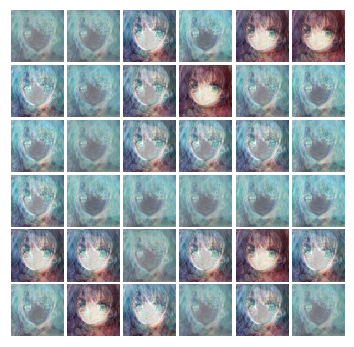


Iter:3400, D:-351.5, G:-34.58
Iter:3405, D:-391.4, G:-4.924
Iter:3410, D:-400.5, G:-66.42
Iter:3415, D:-399.8, G:-47.67
Iter:3420, D:-429.6, G:-42.28
Iter:3425, D:-376.7, G:-38.49
Iter:3430, D:-347.9, G:-82.07
Iter:3435, D:-356.9, G:-115.7
Iter:3440, D:-390.3, G:-67.35
Iter:3445, D:-421.7, G:-39.08
Iter:3450, D:-406.1, G:-62.72
Iter:3455, D:-415.3, G:-67.2
Iter:3460, D:-339.0, G:-64.87
Iter:3465, D:-336.5, G:-37.83
Iter:3470, D:-362.9, G:-54.36
Iter:3475, D:-407.9, G:-76.99
Iter:3480, D:-408.2, G:-82.56
Iter:3485, D:-442.4, G:-90.23
Iter:3490, D:-354.1, G:-40.11
Iter:3495, D:-385.1, G:-74.19
Iter:3500, D:-423.3, G:-65.7
Iter:3505, D:-383.0, G:-52.25
Iter:3510, D:-348.2, G:-64.53
Iter:3515, D:-344.2, G:-95.16
Iter:3520, D:-324.9, G:-80.95
Iter:3525, D:-357.1, G:-127.7
Iter:3530, D:-319.5, G:-66.14
Iter:3535, D:-346.0, G:-67.16
Iter:3540, D:-293.9, G:-72.74
Iter:3545, D:-335.3, G:-72.02
Iter:3550, D:-313.2, G:-79.52
Iter:3555, D:-370.0, G:-79.95
Iter:3560, D:-386.0, G:-68.02
Iter:3565, 

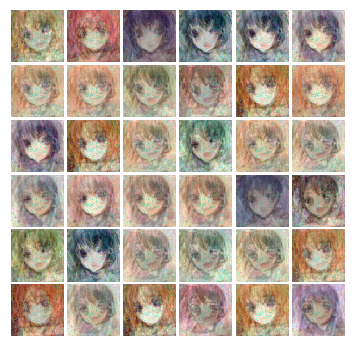


Iter:3600, D:-315.1, G:-151.2
Iter:3605, D:-279.7, G:-138.0
Iter:3610, D:-365.4, G:-104.0
Iter:3615, D:-309.7, G:-78.45
Iter:3620, D:-340.5, G:-108.6
Iter:3625, D:-289.3, G:-107.7
Iter:3630, D:-328.7, G:-80.37
Iter:3635, D:-371.0, G:-100.6
Iter:3640, D:-354.2, G:-102.0
Iter:3645, D:-328.4, G:-112.9
Iter:3650, D:-372.6, G:-109.0
Iter:3655, D:-343.2, G:-61.59
Iter:3660, D:-351.6, G:-88.37
Iter:3665, D:-344.7, G:-84.09
Iter:3670, D:-345.7, G:-109.0
Iter:3675, D:-349.0, G:-116.0
Iter:3680, D:-360.6, G:-84.19
Iter:3685, D:-386.5, G:-136.3
Iter:3690, D:-385.6, G:-116.5
Iter:3695, D:-349.2, G:-104.6
Iter:3700, D:-406.6, G:-91.38
Iter:3705, D:-263.7, G:-147.3
Iter:3710, D:-329.4, G:-73.39
Iter:3715, D:-414.2, G:-113.4
Iter:3720, D:-393.6, G:-84.44
Iter:3725, D:-373.1, G:-100.7
Iter:3730, D:-385.5, G:-74.58
Iter:3735, D:-379.6, G:-101.8
Iter:3740, D:-394.7, G:-74.29
Iter:3745, D:-351.3, G:-127.9
Iter:3750, D:-400.0, G:-101.0
Iter:3755, D:-342.5, G:-14.2
Iter:3760, D:-427.3, G:-82.67
Iter:3765,

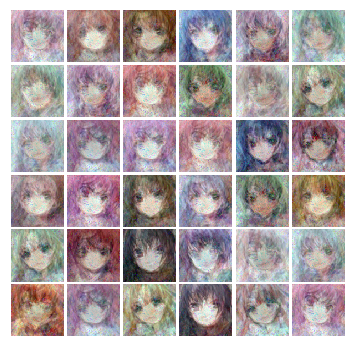


Iter:3800, D:-381.5, G:-67.9
Iter:3805, D:-369.4, G:-73.1
Iter:3810, D:-393.9, G:-49.53
Iter:3815, D:-437.8, G:-87.53
Iter:3820, D:-411.3, G:-94.33
Iter:3825, D:-403.9, G:-64.89
Iter:3830, D:-401.4, G:-65.84
Iter:3835, D:-419.0, G:-43.08
Iter:3840, D:-364.5, G:-60.74
Iter:3845, D:-382.0, G:-75.13
Iter:3850, D:-382.9, G:-53.13
Iter:3855, D:-432.6, G:-73.63
Iter:3860, D:-456.4, G:-64.07
Iter:3865, D:-388.4, G:-51.7
Iter:3870, D:-369.1, G:-32.74
Iter:3875, D:-375.6, G:-73.09
Iter:3880, D:-418.0, G:-18.41
Iter:3885, D:-318.4, G:-63.58
Iter:3890, D:-252.3, G:35.73
Iter:3895, D:-354.0, G:-51.45
Iter:3900, D:-407.7, G:-68.79
Iter:3905, D:-357.7, G:-69.17
Iter:3910, D:-426.9, G:-38.96
Iter:3915, D:-350.3, G:-36.31
Iter:3920, D:-410.3, G:-53.17
Iter:3925, D:-387.7, G:-70.02
Iter:3930, D:-371.8, G:-133.5
Iter:3935, D:-398.1, G:-67.18
Iter:3940, D:-378.5, G:-60.35
Iter:3945, D:-298.3, G:-89.99
Iter:3950, D:-365.1, G:-88.8
Iter:3955, D:-451.7, G:-50.59
Iter:3960, D:-388.6, G:-117.5
Iter:3965, D:-

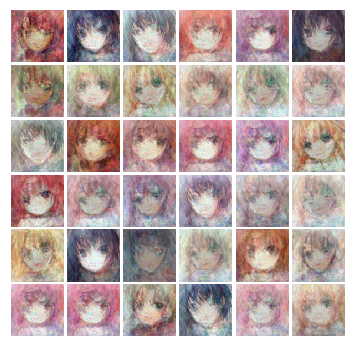


Iter:4000, D:-455.1, G:-25.69
Iter:4005, D:-397.4, G:-62.33
Iter:4010, D:-388.0, G:-98.08
Iter:4015, D:-344.7, G:-81.87
Iter:4020, D:-377.0, G:-78.71
Iter:4025, D:-423.9, G:-113.1
Iter:4030, D:-422.8, G:-48.47
Iter:4035, D:-430.5, G:-95.68
Iter:4040, D:-334.1, G:-68.07
Iter:4045, D:-442.9, G:-134.9
Iter:4050, D:-413.2, G:-47.65
Iter:4055, D:-435.8, G:-51.52
Iter:4060, D:-392.9, G:-12.2
Iter:4065, D:-360.7, G:-20.9
Iter:4070, D:-327.7, G:-59.81
Iter:4075, D:-377.1, G:-13.13
Iter:4080, D:-384.8, G:26.48
Iter:4085, D:-417.5, G:-76.96
Iter:4090, D:-395.4, G:-33.19
Iter:4095, D:-422.9, G:-7.092
Iter:4100, D:-363.4, G:-100.9
Iter:4105, D:-416.1, G:-74.27
Iter:4110, D:-390.9, G:-29.95
Iter:4115, D:-353.2, G:-56.73
Iter:4120, D:-346.9, G:-73.8
Iter:4125, D:-382.6, G:-83.44
Iter:4130, D:-352.8, G:-89.83
Iter:4135, D:-459.1, G:-122.0
Iter:4140, D:-355.2, G:-10.25
Iter:4145, D:-402.0, G:-60.72
Iter:4150, D:-393.9, G:-69.91
Iter:4155, D:-413.7, G:-77.56
Iter:4160, D:-377.9, G:-48.36
Iter:4165, D:

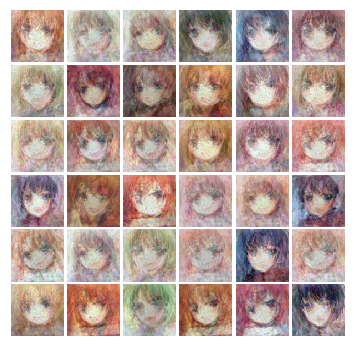


Iter:4200, D:-353.4, G:-50.86
Iter:4205, D:-442.1, G:-27.8
Iter:4210, D:-470.8, G:-84.58
Iter:4215, D:-448.8, G:-58.86
Iter:4220, D:-432.9, G:31.77
Iter:4225, D:-442.2, G:-52.31
Iter:4230, D:-336.9, G:-49.58
Iter:4235, D:-400.4, G:-43.52
Iter:4240, D:-388.7, G:-36.72
Iter:4245, D:-477.7, G:-40.64
Iter:4250, D:-353.0, G:-82.32
Iter:4255, D:-371.6, G:-44.23
Iter:4260, D:-381.5, G:-72.85
Iter:4265, D:-393.2, G:-48.99
Iter:4270, D:-350.9, G:-75.86
Iter:4275, D:-371.1, G:-40.54
Iter:4280, D:-343.6, G:-40.62
Iter:4285, D:-311.6, G:-76.88
Iter:4290, D:-427.5, G:-114.7
Iter:4295, D:-374.3, G:-78.45
Iter:4300, D:-484.8, G:-92.7
Iter:4305, D:-490.2, G:-76.44
Iter:4310, D:-477.5, G:-92.6
Iter:4315, D:-468.8, G:-64.16
Iter:4320, D:-431.1, G:-72.0
Iter:4325, D:-429.7, G:-59.22
Iter:4330, D:-441.7, G:-72.65
Iter:4335, D:-426.8, G:-38.38
Iter:4340, D:-393.7, G:-64.96
Iter:4345, D:-420.1, G:-59.29
Iter:4350, D:-484.9, G:-44.35
Iter:4355, D:-462.6, G:-95.72
Iter:4360, D:-462.1, G:-101.9
Iter:4365, D:-

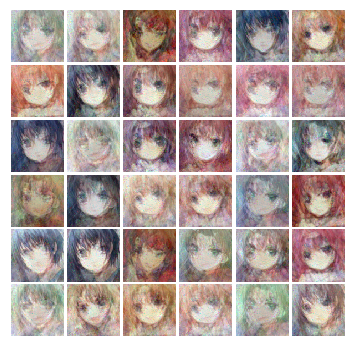


Iter:4400, D:-423.1, G:-57.01
Iter:4405, D:-397.0, G:-84.73
Iter:4410, D:-432.7, G:-109.4
Iter:4415, D:-342.6, G:-36.05
Iter:4420, D:-432.8, G:-55.42
Iter:4425, D:-314.6, G:-58.18
Iter:4430, D:-293.3, G:-61.46
Iter:4435, D:-343.9, G:-44.6
Iter:4440, D:-333.5, G:-81.38
Iter:4445, D:-460.6, G:-65.22
Iter:4450, D:-443.1, G:-81.2
Iter:4455, D:-419.4, G:-45.12
Iter:4460, D:-440.9, G:-61.49
Iter:4465, D:-313.6, G:-9.52
Iter:4470, D:-492.1, G:-66.66
Iter:4475, D:-483.3, G:-61.05
Iter:4480, D:-362.6, G:-65.4
Iter:4485, D:-425.6, G:-118.0
Iter:4490, D:-395.8, G:-80.21
Iter:4495, D:-384.7, G:-49.05
Iter:4500, D:-396.7, G:-68.24
Iter:4505, D:-419.7, G:-71.17
Iter:4510, D:-408.8, G:-46.98
Iter:4515, D:-513.1, G:-98.28
Iter:4520, D:-464.4, G:-49.0
Iter:4525, D:-284.5, G:-33.63
Iter:4530, D:-377.2, G:-78.33
Iter:4535, D:-427.9, G:-82.43
Iter:4540, D:-492.6, G:-107.4
Iter:4545, D:-342.8, G:-26.28
Iter:4550, D:-439.6, G:-46.79
Iter:4555, D:-419.0, G:-86.25
Iter:4560, D:-420.0, G:-84.71
Iter:4565, D:-

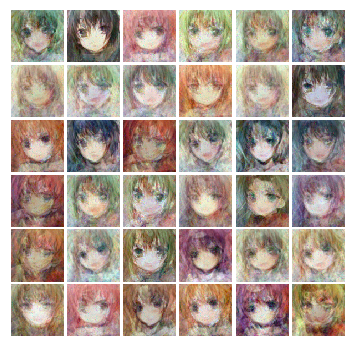


Iter:4600, D:-496.9, G:-74.43
Iter:4605, D:-391.2, G:-66.9
Iter:4610, D:-431.6, G:-12.19
Iter:4615, D:-357.7, G:-77.3
Iter:4620, D:-390.0, G:-125.7
Iter:4625, D:-441.8, G:-8.739
Iter:4630, D:-399.1, G:-96.26
Iter:4635, D:-415.8, G:-84.33
Iter:4640, D:-475.9, G:-43.54
Iter:4645, D:-456.6, G:-78.14
Iter:4650, D:-475.3, G:-101.5
Iter:4655, D:-254.9, G:-26.2
Iter:4660, D:-496.8, G:-53.9
Iter:4665, D:-398.1, G:-63.82
Iter:4670, D:-443.6, G:-104.5
Iter:4675, D:-291.0, G:-38.34
Iter:4680, D:-417.4, G:-78.48
Iter:4685, D:-511.8, G:-101.9
Iter:4690, D:-449.4, G:-39.39
Iter:4695, D:-424.2, G:-67.8
Iter:4700, D:-457.6, G:-36.68
Iter:4705, D:-368.9, G:-87.31
Iter:4710, D:-425.6, G:-71.99
Iter:4715, D:-473.1, G:-57.88
Iter:4720, D:-450.1, G:-81.85
Iter:4725, D:-467.3, G:-71.77
Iter:4730, D:-462.3, G:-83.1
Iter:4735, D:-472.4, G:-92.71
Iter:4740, D:-449.2, G:-77.01
Iter:4745, D:-407.2, G:-60.05
Iter:4750, D:-298.5, G:-61.75
Iter:4755, D:-342.0, G:-54.34
Iter:4760, D:-438.3, G:-103.4
Iter:4765, D:-4

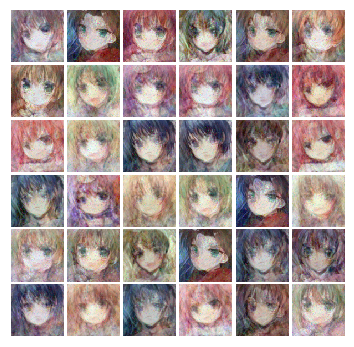


Iter:4800, D:-435.8, G:-77.33
Iter:4805, D:-409.3, G:-21.78
Iter:4810, D:-242.0, G:-68.8
Iter:4815, D:-450.8, G:-89.19
Iter:4820, D:-443.4, G:-82.09
Iter:4825, D:-451.4, G:-49.24
Iter:4830, D:-422.4, G:-21.77
Iter:4835, D:-453.1, G:-112.5
Iter:4840, D:-262.2, G:-115.2
Iter:4845, D:-487.9, G:-49.33
Iter:4850, D:-387.6, G:-65.86
Iter:4855, D:-444.8, G:-76.77
Iter:4860, D:-445.1, G:-53.28
Iter:4865, D:-383.0, G:-98.23
Iter:4870, D:-495.5, G:-74.66
Iter:4875, D:-406.0, G:-53.87
Iter:4880, D:-465.1, G:-98.5
Iter:4885, D:-421.5, G:-94.91
Iter:4890, D:-575.8, G:-98.16
Iter:4895, D:-345.0, G:-51.47
Iter:4900, D:-413.2, G:-92.96
Iter:4905, D:-409.9, G:-78.4
Iter:4910, D:-334.3, G:-88.64
Iter:4915, D:-463.9, G:-78.66
Iter:4920, D:-475.0, G:-91.15
Iter:4925, D:-466.3, G:-29.83
Iter:4930, D:-380.5, G:-78.65
Iter:4935, D:-305.0, G:-54.08
Iter:4940, D:-325.7, G:-80.66
Iter:4945, D:-394.5, G:-56.53
Iter:4950, D:-265.8, G:-53.64
Iter:4955, D:-284.5, G:-80.39
Iter:4960, D:-359.4, G:-63.17
Iter:4965, D

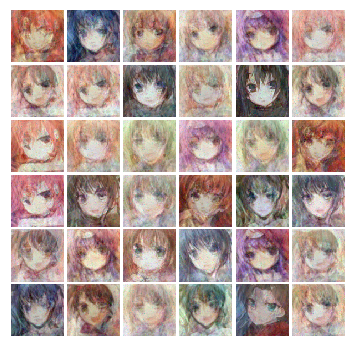


Iter:5000, D:-444.2, G:-88.28
Iter:5005, D:-392.1, G:-57.94
Iter:5010, D:-439.8, G:-48.83
Iter:5015, D:-446.8, G:-80.11
Iter:5020, D:-388.5, G:-75.03
Iter:5025, D:-378.0, G:-64.45
Iter:5030, D:-462.5, G:-79.77
Iter:5035, D:-346.2, G:-86.68
Iter:5040, D:-403.8, G:-35.24
Iter:5045, D:-291.9, G:-96.86
Iter:5050, D:-364.1, G:-90.61
Iter:5055, D:-415.4, G:-37.13
Iter:5060, D:-408.2, G:-61.88
Iter:5065, D:-436.6, G:-87.45
Iter:5070, D:-372.2, G:-69.78
Iter:5075, D:-373.3, G:-31.4
Iter:5080, D:-367.4, G:-66.95
Iter:5085, D:-301.5, G:-32.38
Iter:5090, D:-361.6, G:-62.8
Iter:5095, D:-340.8, G:-52.43
Iter:5100, D:-407.3, G:-59.48
Iter:5105, D:-323.0, G:-65.01
Iter:5110, D:-374.3, G:-79.46
Iter:5115, D:-329.6, G:-40.36
Iter:5120, D:-363.0, G:-27.17
Iter:5125, D:-310.0, G:-74.27
Iter:5130, D:-394.5, G:-61.58
Iter:5135, D:-323.4, G:-46.75
Iter:5140, D:-363.5, G:-48.85
Iter:5145, D:-342.6, G:-9.199
Iter:5150, D:-350.2, G:-64.48
Iter:5155, D:-330.7, G:-87.14
Iter:5160, D:-328.2, G:-45.88
Iter:5165, 

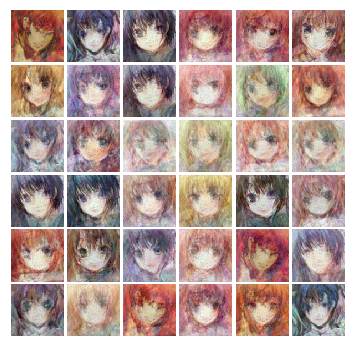


Iter:5200, D:-325.9, G:-50.51
Iter:5205, D:-372.8, G:-63.21
Iter:5210, D:-331.3, G:-53.16
Iter:5215, D:-410.9, G:-88.53
Iter:5220, D:-366.2, G:-47.1
Iter:5225, D:-394.5, G:-71.03
Iter:5230, D:-326.6, G:-81.15
Iter:5235, D:-390.4, G:-67.6
Iter:5240, D:-317.6, G:-26.99
Iter:5245, D:-366.6, G:-49.71
Iter:5250, D:-303.3, G:-70.39
Iter:5255, D:-360.3, G:-60.21
Iter:5260, D:-306.9, G:-30.56
Iter:5265, D:-397.0, G:-54.68
Iter:5270, D:-353.7, G:-46.24
Iter:5275, D:-320.0, G:-53.45
Iter:5280, D:-371.9, G:-71.63
Iter:5285, D:-347.0, G:-56.56
Iter:5290, D:-353.6, G:-35.39
Iter:5295, D:-292.6, G:-43.14
Iter:5300, D:-327.7, G:-76.67
Iter:5305, D:-385.0, G:-60.73
Iter:5310, D:-317.2, G:-48.9
Iter:5315, D:-338.2, G:-56.1
Iter:5320, D:-366.9, G:-61.03
Iter:5325, D:-370.9, G:-55.1
Iter:5330, D:-333.3, G:-57.82
Iter:5335, D:-350.5, G:-59.21
Iter:5340, D:-342.9, G:-71.76
Iter:5345, D:-319.3, G:-47.74
Iter:5350, D:-351.9, G:-37.67
Iter:5355, D:-319.9, G:-62.4
Iter:5360, D:-273.1, G:-34.59
Iter:5365, D:-3

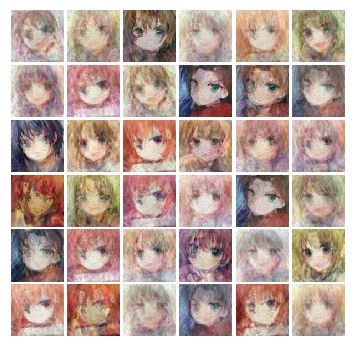


Iter:5400, D:-375.1, G:-78.18
Iter:5405, D:-356.6, G:-71.84
Iter:5410, D:-314.1, G:-60.5
Iter:5415, D:-352.8, G:-57.18
Iter:5420, D:-409.4, G:-86.73
Iter:5425, D:-465.2, G:-68.51
Iter:5430, D:-348.1, G:-37.64
Iter:5435, D:-288.5, G:-2.322
Iter:5440, D:-371.2, G:-61.63
Iter:5445, D:-379.8, G:-47.26
Iter:5450, D:-331.1, G:-43.07
Iter:5455, D:-293.1, G:-54.24
Iter:5460, D:-352.2, G:-34.22
Iter:5465, D:-276.4, G:-53.31
Iter:5470, D:-289.1, G:-23.59
Iter:5475, D:-405.2, G:-87.2
Iter:5480, D:-334.3, G:-74.23
Iter:5485, D:-397.4, G:-52.68
Iter:5490, D:-348.2, G:-44.01
Iter:5495, D:-269.3, G:-23.31
Iter:5500, D:-396.9, G:-62.7
Iter:5505, D:-325.3, G:-55.72
Iter:5510, D:-355.5, G:-53.2
Iter:5515, D:-347.1, G:-56.74
Iter:5520, D:-336.7, G:-44.02
Iter:5525, D:-363.6, G:-58.25
Iter:5530, D:-395.9, G:-54.62
Iter:5535, D:-186.2, G:-61.22
Iter:5540, D:-365.0, G:-51.29
Iter:5545, D:-231.5, G:-9.567
Iter:5550, D:-341.7, G:-58.36
Iter:5555, D:-294.9, G:-22.2
Iter:5560, D:-275.8, G:-18.05
Iter:5565, D:-

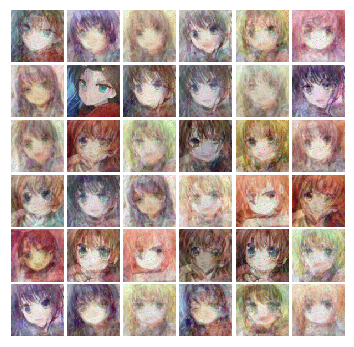


Iter:5600, D:-346.4, G:-53.76
Iter:5605, D:-375.7, G:-49.75
Iter:5610, D:-315.5, G:-65.47
Iter:5615, D:-241.5, G:-27.21
Iter:5620, D:-335.0, G:-39.07
Iter:5625, D:-300.7, G:-64.08
Iter:5630, D:-311.3, G:-63.27
Iter:5635, D:-344.4, G:-50.97
Iter:5640, D:-350.3, G:-41.21
Iter:5645, D:-334.2, G:-37.82
Iter:5650, D:-338.0, G:-57.99
Iter:5655, D:-344.8, G:-46.63
Iter:5660, D:-298.1, G:-57.87
Iter:5665, D:-372.0, G:-61.32
Iter:5670, D:-373.0, G:-48.95
Iter:5675, D:-337.4, G:-82.5
Iter:5680, D:-328.5, G:-71.01
Iter:5685, D:-390.5, G:-31.25
Iter:5690, D:-333.6, G:-52.53
Iter:5695, D:-385.2, G:-42.43
Iter:5700, D:-320.5, G:-41.79
Iter:5705, D:-322.5, G:-24.41
Iter:5710, D:-330.2, G:-30.1
Iter:5715, D:-247.0, G:-19.74
Iter:5720, D:-365.6, G:-62.25
Iter:5725, D:-291.8, G:-45.2
Iter:5730, D:-306.1, G:-60.09
Iter:5735, D:-393.1, G:-79.73
Iter:5740, D:-294.7, G:-37.5
Iter:5745, D:-336.2, G:-42.63
Iter:5750, D:-298.4, G:-32.96
Iter:5755, D:-340.2, G:-53.15
Iter:5760, D:-334.9, G:-67.02
Iter:5765, D:

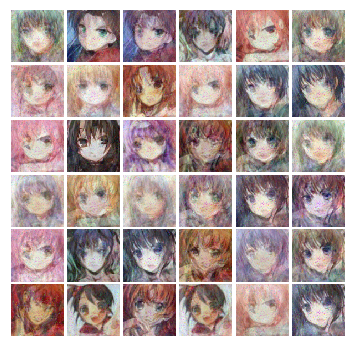


Iter:5800, D:-323.7, G:-42.49
Iter:5805, D:-285.8, G:-64.81
Iter:5810, D:-318.3, G:-45.2
Iter:5815, D:-324.9, G:-44.19
Iter:5820, D:-350.3, G:-55.07
Iter:5825, D:-313.3, G:-54.54
Iter:5830, D:-354.2, G:-74.64
Iter:5835, D:-332.1, G:-75.54
Iter:5840, D:-338.9, G:-52.11
Iter:5845, D:-334.3, G:-53.14
Iter:5850, D:-342.8, G:-50.68
Iter:5855, D:-295.2, G:-59.11
Iter:5860, D:-291.7, G:-56.98
Iter:5865, D:-319.4, G:-75.02
Iter:5870, D:-311.7, G:-57.82
Iter:5875, D:-313.7, G:-54.58
Iter:5880, D:-292.3, G:-42.68
Iter:5885, D:-374.9, G:-78.07
Iter:5890, D:-344.3, G:-68.72
Iter:5895, D:-305.4, G:-56.38
Iter:5900, D:-336.3, G:-51.64
Iter:5905, D:-281.0, G:-48.7
Iter:5910, D:-277.2, G:-52.84
Iter:5915, D:-365.4, G:-74.81
Iter:5920, D:-248.9, G:-66.45
Iter:5925, D:-259.6, G:-41.73
Iter:5930, D:-314.7, G:-55.36
Iter:5935, D:-367.0, G:-54.59
Iter:5940, D:-361.4, G:-54.97
Iter:5945, D:-273.3, G:-35.28
Iter:5950, D:-263.0, G:-58.04
Iter:5955, D:-317.8, G:-20.44
Iter:5960, D:-322.0, G:-34.19
Iter:5965, 

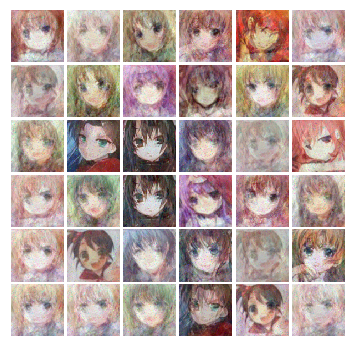


Iter:6000, D:-319.3, G:-59.02
Iter:6005, D:-348.7, G:-51.74
Iter:6010, D:-325.6, G:-51.61
Iter:6015, D:-355.7, G:-37.35
Iter:6020, D:-315.5, G:-53.9
Iter:6025, D:-265.4, G:-40.49
Iter:6030, D:-281.3, G:-36.29
Iter:6035, D:-309.4, G:-54.45
Iter:6040, D:-308.3, G:-47.42
Iter:6045, D:-241.4, G:-58.59
Iter:6050, D:-329.5, G:-58.98
Iter:6055, D:-306.0, G:-23.03
Iter:6060, D:-283.9, G:-49.75
Iter:6065, D:-291.2, G:-54.71
Iter:6070, D:-309.1, G:-42.04
Iter:6075, D:-330.8, G:-40.25
Iter:6080, D:-323.9, G:-55.35
Iter:6085, D:-313.0, G:-62.48
Iter:6090, D:-246.0, G:-31.58
Iter:6095, D:-302.5, G:-40.07
Iter:6100, D:-291.9, G:-43.76
Iter:6105, D:-267.1, G:-42.62
Iter:6110, D:-290.5, G:-35.81
Iter:6115, D:-313.7, G:-45.48
Iter:6120, D:-265.3, G:-23.61
Iter:6125, D:-319.6, G:-62.89
Iter:6130, D:-258.1, G:-70.81
Iter:6135, D:-244.7, G:-18.01
Iter:6140, D:-291.2, G:-28.87
Iter:6145, D:-306.6, G:-46.82
Iter:6150, D:-241.3, G:-42.69
Iter:6155, D:-286.6, G:-71.08
Iter:6160, D:-235.2, G:-21.39
Iter:6165,

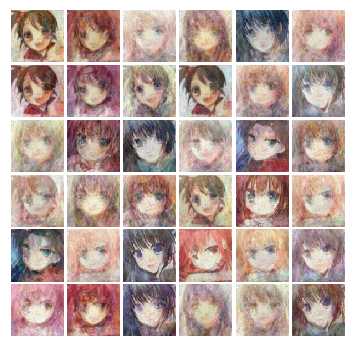


Iter:6200, D:-290.7, G:-42.45
Iter:6205, D:-295.6, G:-63.95
Iter:6210, D:-263.0, G:-57.32
Iter:6215, D:-318.9, G:-66.59
Iter:6220, D:-329.4, G:-44.37
Iter:6225, D:-271.9, G:-57.74
Iter:6230, D:-303.0, G:-53.19
Iter:6235, D:-281.2, G:-48.86
Iter:6240, D:-364.3, G:-44.35
Iter:6245, D:-279.5, G:-53.08
Iter:6250, D:-290.3, G:-53.72
Iter:6255, D:-332.5, G:-43.5
Iter:6260, D:-316.1, G:-89.96
Iter:6265, D:-175.8, G:-22.24
Iter:6270, D:-294.1, G:-71.07
Iter:6275, D:-284.8, G:-85.85
Iter:6280, D:-338.6, G:-63.32
Iter:6285, D:-283.2, G:-35.69
Iter:6290, D:-342.3, G:-50.22
Iter:6295, D:-308.4, G:-39.81
Iter:6300, D:-248.3, G:-33.88
Iter:6305, D:-331.2, G:-53.14
Iter:6310, D:-279.4, G:-36.53
Iter:6315, D:-296.2, G:-33.19
Iter:6320, D:-285.3, G:-54.85
Iter:6325, D:-211.0, G:-21.2
Iter:6330, D:-232.1, G:-27.41
Iter:6335, D:-334.5, G:-61.96
Iter:6340, D:-305.1, G:-69.39
Iter:6345, D:-285.5, G:-53.45
Iter:6350, D:-331.1, G:-69.57
Iter:6355, D:-311.4, G:-31.81
Iter:6360, D:-299.0, G:-40.9
Iter:6365, D

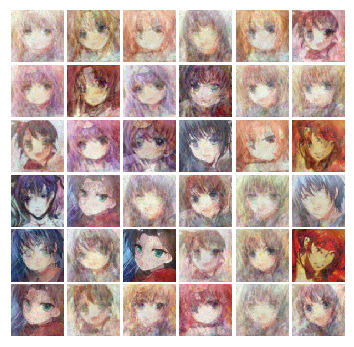


Iter:6400, D:-280.7, G:-48.02
Iter:6405, D:-277.9, G:-45.27
Iter:6410, D:-212.1, G:-41.06
Iter:6415, D:-293.8, G:-46.16
Iter:6420, D:-308.2, G:-41.93
Iter:6425, D:-322.9, G:-53.31
Iter:6430, D:-265.7, G:-51.45
Iter:6435, D:-255.5, G:-42.28
Iter:6440, D:-274.9, G:-65.44
Iter:6445, D:-271.2, G:-40.46
Iter:6450, D:-239.7, G:-49.68
Iter:6455, D:-296.6, G:-61.93
Iter:6460, D:-234.5, G:-42.68
Iter:6465, D:-249.7, G:-51.32
Iter:6470, D:-291.1, G:-52.54
Iter:6475, D:-294.2, G:-43.29
Iter:6480, D:-279.0, G:-46.38
Iter:6485, D:-290.3, G:-34.34
Iter:6490, D:-253.8, G:-43.11
Iter:6495, D:-262.0, G:-48.89
Iter:6500, D:-291.1, G:-39.07
Iter:6505, D:-220.3, G:-22.62
Iter:6510, D:-239.6, G:-23.08
Iter:6515, D:-209.1, G:-26.28
Iter:6520, D:-286.3, G:-74.59
Iter:6525, D:-235.3, G:-40.76
Iter:6530, D:-254.5, G:-37.68
Iter:6535, D:-265.8, G:-59.95
Iter:6540, D:-251.1, G:-43.51
Iter:6545, D:-216.1, G:-38.47
Iter:6550, D:-235.0, G:-43.78
Iter:6555, D:-237.1, G:-40.97
Iter:6560, D:-247.0, G:-44.93
Iter:6565

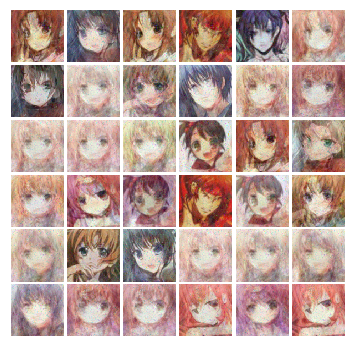


Iter:6600, D:-246.5, G:-66.71
Iter:6605, D:-242.2, G:-40.84
Iter:6610, D:-293.3, G:-87.84
Iter:6615, D:-265.5, G:-69.55
Iter:6620, D:-250.6, G:-57.86
Iter:6625, D:-272.0, G:-73.19
Iter:6630, D:-278.1, G:-66.11
Iter:6635, D:-273.7, G:-56.59
Iter:6640, D:-249.1, G:-36.23
Iter:6645, D:-276.9, G:-46.22
Iter:6650, D:-240.0, G:-66.68
Iter:6655, D:-283.6, G:-60.53
Iter:6660, D:-290.2, G:-77.0
Iter:6665, D:-246.8, G:-65.62
Iter:6670, D:-247.7, G:-64.58
Iter:6675, D:-232.6, G:-42.82
Iter:6680, D:-252.9, G:-57.27
Iter:6685, D:-273.4, G:-69.97
Iter:6690, D:-217.6, G:-31.27
Iter:6695, D:-206.6, G:-49.82
Iter:6700, D:-258.1, G:-50.97
Iter:6705, D:-280.2, G:-58.22
Iter:6710, D:-231.2, G:-49.02
Iter:6715, D:-242.8, G:-63.01
Iter:6720, D:-233.9, G:-68.33
Iter:6725, D:-272.3, G:-74.15
Iter:6730, D:-155.1, G:-53.78
Iter:6735, D:-255.2, G:-59.38
Iter:6740, D:-230.6, G:-51.44
Iter:6745, D:-287.7, G:-61.94
Iter:6750, D:-235.4, G:-34.67
Iter:6755, D:-272.8, G:-55.48
Iter:6760, D:-294.8, G:-62.67
Iter:6765,

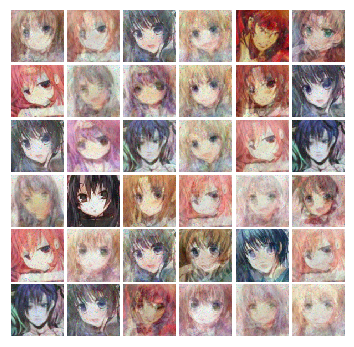


Iter:6800, D:-303.4, G:-73.22
Iter:6805, D:-309.4, G:-68.35
Iter:6810, D:-304.0, G:-56.35
Iter:6815, D:-273.2, G:-26.73
Iter:6820, D:-225.0, G:-43.58
Iter:6825, D:-272.8, G:-54.11
Iter:6830, D:-231.7, G:-33.93
Iter:6835, D:-270.5, G:-75.37
Iter:6840, D:-237.3, G:-66.37
Iter:6845, D:-245.4, G:-68.49
Iter:6850, D:-245.6, G:-64.43
Iter:6855, D:-253.1, G:-59.83
Iter:6860, D:-209.5, G:-41.35
Iter:6865, D:-253.3, G:-37.71
Iter:6870, D:-233.3, G:-78.03
Iter:6875, D:-256.4, G:-47.62
Iter:6880, D:-257.9, G:-57.76
Iter:6885, D:-264.5, G:-74.32
Iter:6890, D:-279.8, G:-44.69
Iter:6895, D:-208.3, G:-52.94
Iter:6900, D:-247.2, G:-36.83
Iter:6905, D:-271.8, G:-62.12
Iter:6910, D:-266.2, G:-55.45
Iter:6915, D:-296.9, G:-59.92
Iter:6920, D:-243.3, G:-70.53
Iter:6925, D:-215.4, G:-57.0
Iter:6930, D:-283.7, G:-77.26
Iter:6935, D:-270.5, G:-52.58
Iter:6940, D:-256.6, G:-45.95
Iter:6945, D:-326.9, G:-49.42
Iter:6950, D:-255.7, G:-58.51
Iter:6955, D:-244.7, G:-76.73
Iter:6960, D:-280.1, G:-72.01
Iter:6965,

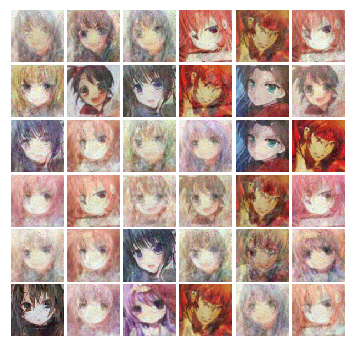


Iter:7000, D:-228.3, G:-42.2
Iter:7005, D:-236.1, G:-52.18
Iter:7010, D:-201.3, G:-26.37
Iter:7015, D:-185.5, G:-48.19
Iter:7020, D:-239.3, G:-41.18
Iter:7025, D:-260.8, G:-39.03
Iter:7030, D:-240.3, G:-66.59
Iter:7035, D:-238.9, G:-34.15
Iter:7040, D:-229.2, G:-43.53
Iter:7045, D:-232.4, G:-53.34
Iter:7050, D:-272.4, G:-60.07
Iter:7055, D:-244.4, G:-71.26
Iter:7060, D:-270.0, G:-82.7
Iter:7065, D:-267.3, G:-46.71
Iter:7070, D:-247.7, G:-69.37
Iter:7075, D:-184.5, G:-52.68
Iter:7080, D:-222.1, G:-72.14
Iter:7085, D:-296.5, G:-58.49
Iter:7090, D:-260.2, G:-50.59
Iter:7095, D:-278.0, G:-65.9
Iter:7100, D:-271.7, G:-62.35
Iter:7105, D:-244.9, G:-58.34
Iter:7110, D:-247.6, G:-44.42
Iter:7115, D:-222.0, G:-76.58
Iter:7120, D:-247.8, G:-60.96
Iter:7125, D:-217.5, G:-62.88
Iter:7130, D:-240.8, G:-31.08
Iter:7135, D:-305.6, G:-64.55
Iter:7140, D:-237.3, G:-65.31
Iter:7145, D:-243.9, G:-50.27
Iter:7150, D:-229.1, G:-33.3
Iter:7155, D:-255.9, G:-83.83
Iter:7160, D:-246.5, G:-53.79
Iter:7165, D:

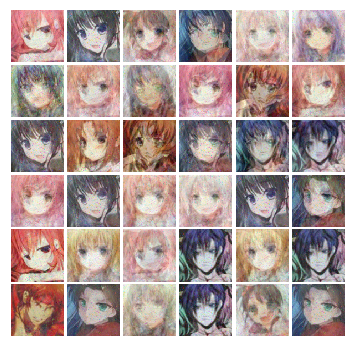


Iter:7200, D:-242.8, G:-60.24
Iter:7205, D:-262.3, G:-52.62
Iter:7210, D:-287.6, G:-67.38
Iter:7215, D:-254.6, G:-46.85
Iter:7220, D:-244.6, G:-76.49
Iter:7225, D:-250.6, G:-85.35
Iter:7230, D:-292.7, G:-70.18
Iter:7235, D:-242.9, G:-49.35
Iter:7240, D:-252.3, G:-45.24
Iter:7245, D:-234.1, G:-46.95
Iter:7250, D:-243.9, G:-50.15
Iter:7255, D:-248.9, G:-65.82
Iter:7260, D:-251.0, G:-44.93
Iter:7265, D:-220.1, G:-51.28
Iter:7270, D:-254.0, G:-55.16
Iter:7275, D:-247.8, G:-45.5
Iter:7280, D:-253.1, G:-67.53
Iter:7285, D:-235.8, G:-90.43
Iter:7290, D:-196.1, G:-65.49
Iter:7295, D:-237.3, G:-49.0
Iter:7300, D:-221.8, G:-42.06
Iter:7305, D:-239.9, G:-48.0
Iter:7310, D:-209.7, G:-64.06
Iter:7315, D:-231.7, G:-48.26
Iter:7320, D:-243.8, G:-60.91
Iter:7325, D:-200.8, G:-53.76
Iter:7330, D:-245.1, G:-53.52
Iter:7335, D:-233.4, G:-51.3
Iter:7340, D:-241.6, G:-54.23
Iter:7345, D:-207.3, G:-45.01
Iter:7350, D:-184.1, G:-50.05
Iter:7355, D:-272.8, G:-63.36
Iter:7360, D:-246.9, G:-66.4
Iter:7365, D:-

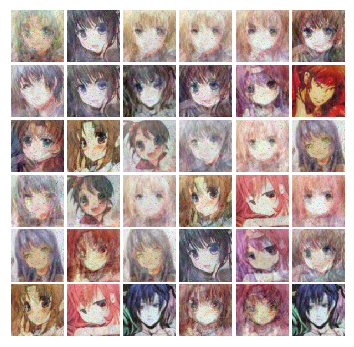


Iter:7400, D:-267.1, G:-53.26
Iter:7405, D:-229.2, G:-53.44
Iter:7410, D:-219.4, G:-37.92
Iter:7415, D:-247.0, G:-56.04
Iter:7420, D:-246.3, G:-45.87
Iter:7425, D:-252.7, G:-58.12
Iter:7430, D:-238.5, G:-32.55
Iter:7435, D:-255.9, G:-65.82
Iter:7440, D:-249.5, G:-72.08
Iter:7445, D:-174.8, G:-58.01
Iter:7450, D:-222.5, G:-81.28
Iter:7455, D:-231.8, G:-31.32
Iter:7460, D:-238.8, G:-64.85
Iter:7465, D:-174.8, G:-46.23
Iter:7470, D:-287.7, G:-77.93
Iter:7475, D:-198.9, G:-45.63
Iter:7480, D:-241.5, G:-65.24
Iter:7485, D:-234.7, G:-44.08
Iter:7490, D:-238.7, G:-74.24
Iter:7495, D:-260.3, G:-51.07
Iter:7500, D:-246.7, G:-51.22
Iter:7505, D:-252.9, G:-83.38
Iter:7510, D:-235.8, G:-68.09
Iter:7515, D:-225.6, G:-60.32
Iter:7520, D:-210.3, G:-72.08
Iter:7525, D:-211.7, G:-53.58
Iter:7530, D:-169.9, G:-50.48
Iter:7535, D:-259.9, G:-72.91
Iter:7540, D:-240.9, G:-76.49
Iter:7545, D:-211.5, G:-52.93
Iter:7550, D:-224.9, G:-40.39
Iter:7555, D:-233.8, G:-61.44
Iter:7560, D:-245.8, G:-68.64
Iter:7565

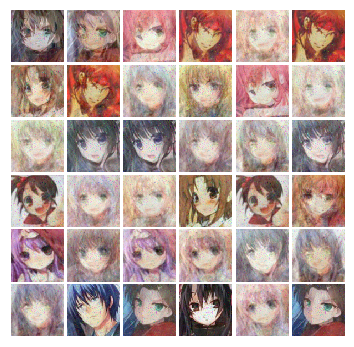


Iter:7600, D:-224.2, G:-48.24
Iter:7605, D:-253.4, G:-60.01
Iter:7610, D:-271.8, G:-67.23
Iter:7615, D:-212.3, G:-28.56
Iter:7620, D:-251.2, G:-62.44
Iter:7625, D:-232.3, G:-46.92
Iter:7630, D:-202.6, G:-48.46
Iter:7635, D:-251.3, G:-66.17
Iter:7640, D:-193.2, G:-35.14
Iter:7645, D:-240.0, G:-54.03
Iter:7650, D:-223.3, G:-49.61
Iter:7655, D:-244.4, G:-58.78
Iter:7660, D:-225.0, G:-64.31
Iter:7665, D:-236.1, G:-60.14
Iter:7670, D:-282.9, G:-80.22
Iter:7675, D:-204.6, G:-66.33
Iter:7680, D:-253.4, G:-65.51
Iter:7685, D:-227.5, G:-46.88
Iter:7690, D:-240.6, G:-50.45
Iter:7695, D:-234.7, G:-60.4
Iter:7700, D:-125.9, G:-57.21
Iter:7705, D:-223.2, G:-70.79
Iter:7710, D:-231.0, G:-47.65
Iter:7715, D:-192.2, G:-48.55
Iter:7720, D:-228.2, G:-53.57
Iter:7725, D:-276.1, G:-79.67
Iter:7730, D:-217.3, G:-61.06
Iter:7735, D:-219.0, G:-48.65
Iter:7740, D:-228.5, G:-59.26
Iter:7745, D:-276.2, G:-59.62
Iter:7750, D:-205.8, G:-56.94
Iter:7755, D:-205.5, G:-53.67
Iter:7760, D:-188.4, G:-54.44
Iter:7765,

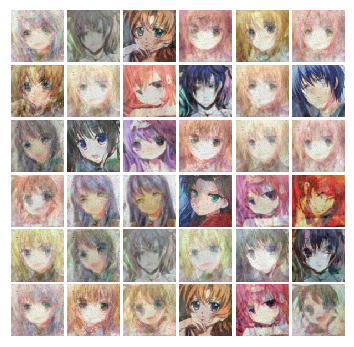


Iter:7800, D:-246.7, G:-59.82
Iter:7805, D:-189.0, G:-54.78
Iter:7810, D:-222.2, G:-55.44
Iter:7815, D:-225.1, G:-49.65
Iter:7820, D:-269.5, G:-70.6
Iter:7825, D:-204.2, G:-45.98
Iter:7830, D:-229.3, G:-58.58
Iter:7835, D:-246.9, G:-57.98
Iter:7840, D:-222.2, G:-72.73
Iter:7845, D:-241.8, G:-47.22
Iter:7850, D:-209.2, G:-58.93
Iter:7855, D:-216.8, G:-46.22
Iter:7860, D:-188.5, G:-49.81
Iter:7865, D:-238.6, G:-61.58
Iter:7870, D:-262.5, G:-46.41
Iter:7875, D:-213.8, G:-62.23
Iter:7880, D:-214.4, G:-51.95
Iter:7885, D:-189.5, G:-50.37
Iter:7890, D:-175.5, G:-36.43
Iter:7895, D:-256.4, G:-64.8
Iter:7900, D:-244.9, G:-59.27
Iter:7905, D:-220.6, G:-28.34
Iter:7910, D:-197.6, G:-51.31
Iter:7915, D:-227.8, G:-57.33
Iter:7920, D:-182.5, G:-54.89
Iter:7925, D:-241.0, G:-52.95
Iter:7930, D:-189.2, G:-56.47
Iter:7935, D:-184.9, G:-57.53
Iter:7940, D:-229.4, G:-56.28
Iter:7945, D:-218.3, G:-60.32
Iter:7950, D:-231.8, G:-68.29
Iter:7955, D:-245.2, G:-58.83
Iter:7960, D:-216.1, G:-30.39
Iter:7965, 

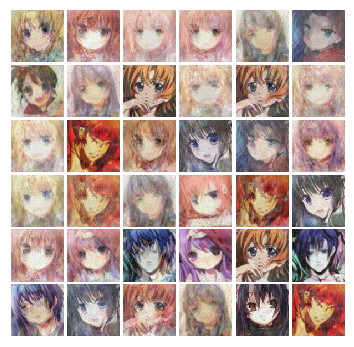


Iter:8000, D:-223.5, G:-63.15
Iter:8005, D:-220.5, G:-60.99
Iter:8010, D:-221.7, G:-42.31
Iter:8015, D:-212.8, G:-58.15
Iter:8020, D:-191.2, G:-36.32
Iter:8025, D:-189.0, G:-54.74
Iter:8030, D:-222.2, G:-53.0
Iter:8035, D:-192.1, G:-44.39
Iter:8040, D:-238.6, G:-43.5
Iter:8045, D:-208.1, G:-48.25
Iter:8050, D:-190.6, G:-24.02
Iter:8055, D:-179.2, G:-50.89
Iter:8060, D:-229.0, G:-44.73
Iter:8065, D:-232.6, G:-40.16
Iter:8070, D:-192.9, G:-45.91
Iter:8075, D:-203.6, G:-59.31
Iter:8080, D:-209.2, G:-58.3
Iter:8085, D:-225.3, G:-56.26
Iter:8090, D:-227.9, G:-55.51
Iter:8095, D:-208.0, G:-45.91
Iter:8100, D:-245.1, G:-51.88
Iter:8105, D:-227.8, G:-48.63
Iter:8110, D:-213.0, G:-30.57
Iter:8115, D:-223.0, G:-60.96
Iter:8120, D:-215.1, G:-57.08
Iter:8125, D:-244.5, G:-57.89
Iter:8130, D:-219.1, G:-45.89
Iter:8135, D:-180.2, G:-64.04
Iter:8140, D:-262.6, G:-68.07
Iter:8145, D:-194.3, G:-38.99
Iter:8150, D:-234.1, G:-55.01
Iter:8155, D:-211.8, G:-55.36
Iter:8160, D:-167.0, G:-44.33
Iter:8165, D

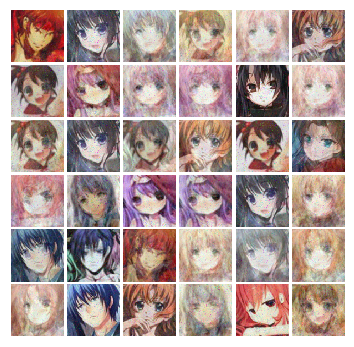


Iter:8200, D:-206.4, G:-46.48
Iter:8205, D:-203.4, G:-54.35
Iter:8210, D:-242.0, G:-61.59
Iter:8215, D:-222.8, G:-51.17
Iter:8220, D:-211.8, G:-61.47
Iter:8225, D:-172.7, G:-41.74
Iter:8230, D:-197.6, G:-46.52
Iter:8235, D:-211.0, G:-59.11
Iter:8240, D:-217.0, G:-56.08
Iter:8245, D:-200.3, G:-40.2
Iter:8250, D:-182.9, G:-33.32
Iter:8255, D:-188.8, G:-48.49
Iter:8260, D:-184.7, G:-47.8
Iter:8265, D:-213.6, G:-22.97
Iter:8270, D:-193.8, G:-30.76
Iter:8275, D:-258.9, G:-70.67
Iter:8280, D:-237.8, G:-60.03
Iter:8285, D:-196.8, G:-64.01
Iter:8290, D:-210.5, G:-38.44
Iter:8295, D:-205.3, G:-60.77
Iter:8300, D:-233.4, G:-65.0
Iter:8305, D:-211.1, G:-58.61
Iter:8310, D:-216.3, G:-42.6
Iter:8315, D:-234.0, G:-49.49
Iter:8320, D:-180.2, G:-56.15
Iter:8325, D:-136.5, G:-21.87
Iter:8330, D:-202.2, G:-41.71
Iter:8335, D:-246.4, G:-47.99
Iter:8340, D:-229.8, G:-56.22
Iter:8345, D:-225.6, G:-47.25
Iter:8350, D:-255.1, G:-48.3
Iter:8355, D:-220.1, G:-55.46
Iter:8360, D:-198.0, G:-33.94
Iter:8365, D:-

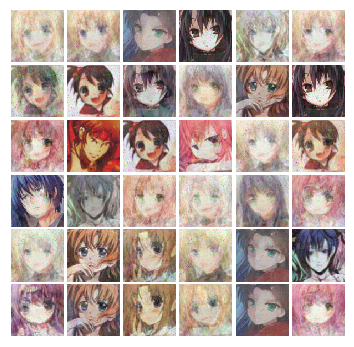


Iter:8400, D:-189.4, G:-35.26
Iter:8405, D:-208.8, G:-47.24
Iter:8410, D:-249.3, G:-64.58
Iter:8415, D:-224.8, G:-55.34
Iter:8420, D:-209.2, G:-40.77
Iter:8425, D:-200.0, G:-59.22
Iter:8430, D:-198.8, G:-42.92
Iter:8435, D:-237.2, G:-58.2
Iter:8440, D:-214.6, G:-49.17
Iter:8445, D:-224.7, G:-54.07
Iter:8450, D:-247.7, G:-66.98
Iter:8455, D:-202.8, G:-43.9
Iter:8460, D:-222.8, G:-44.84
Iter:8465, D:-241.8, G:-66.79
Iter:8470, D:-239.8, G:-77.66
Iter:8475, D:-173.4, G:-55.97
Iter:8480, D:-199.5, G:-52.23
Iter:8485, D:-222.8, G:-69.47
Iter:8490, D:-199.4, G:-55.73
Iter:8495, D:-222.0, G:-39.14
Iter:8500, D:-231.2, G:-59.62
Iter:8505, D:-205.7, G:-52.13
Iter:8510, D:-174.7, G:-51.95
Iter:8515, D:-191.2, G:-49.8
Iter:8520, D:-183.8, G:-62.26
Iter:8525, D:-153.7, G:-27.7
Iter:8530, D:-252.4, G:-54.09
Iter:8535, D:-187.8, G:-56.65
Iter:8540, D:-182.8, G:-40.27
Iter:8545, D:-220.5, G:-28.15
Iter:8550, D:-222.7, G:-52.58
Iter:8555, D:-218.9, G:-43.53
Iter:8560, D:-230.2, G:-68.54
Iter:8565, D:

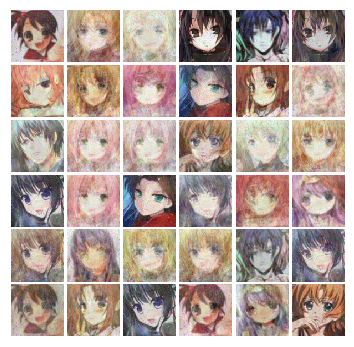


Iter:8600, D:-220.2, G:-75.29
Iter:8605, D:-230.1, G:-59.89
Iter:8610, D:-215.2, G:-45.81
Iter:8615, D:-209.5, G:-53.63
Iter:8620, D:-160.3, G:-38.68
Iter:8625, D:-245.7, G:-39.17
Iter:8630, D:-245.0, G:-62.71
Iter:8635, D:-197.9, G:-34.84
Iter:8640, D:-198.5, G:-37.39
Iter:8645, D:-188.5, G:-41.06
Iter:8650, D:-214.7, G:-47.92
Iter:8655, D:-156.7, G:-14.63
Iter:8660, D:-252.8, G:-60.16
Iter:8665, D:-237.3, G:-40.68
Iter:8670, D:-219.9, G:-44.94
Iter:8675, D:-187.6, G:-59.26
Iter:8680, D:-216.9, G:-58.44
Iter:8685, D:-152.9, G:-46.51
Iter:8690, D:-251.6, G:-60.16
Iter:8695, D:-155.6, G:-46.75
Iter:8700, D:-152.8, G:-44.52
Iter:8705, D:-189.4, G:-27.59
Iter:8710, D:-197.1, G:-41.78
Iter:8715, D:-208.0, G:-41.94
Iter:8720, D:-157.4, G:-49.95
Iter:8725, D:-166.5, G:-58.84
Iter:8730, D:-210.8, G:-44.58
Iter:8735, D:-234.8, G:-60.09
Iter:8740, D:-213.3, G:-70.42
Iter:8745, D:-191.7, G:-61.5
Iter:8750, D:-163.4, G:-52.49
Iter:8755, D:-168.2, G:-33.76
Iter:8760, D:-207.7, G:-51.99
Iter:8765,

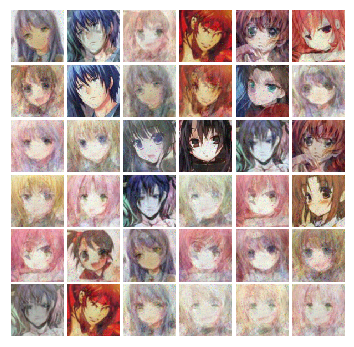


Iter:8800, D:-209.5, G:-66.77
Iter:8805, D:-209.4, G:-47.55
Iter:8810, D:-179.0, G:-22.99
Iter:8815, D:-189.1, G:-35.38
Iter:8820, D:-185.1, G:-29.83
Iter:8825, D:-169.4, G:-32.14
Iter:8830, D:-199.9, G:-37.96
Iter:8835, D:-208.7, G:-57.7
Iter:8840, D:-211.0, G:-29.5
Iter:8845, D:-190.2, G:-46.3
Iter:8850, D:-170.9, G:-39.43
Iter:8855, D:-229.2, G:-48.5
Iter:8860, D:-219.5, G:-53.47
Iter:8865, D:-213.2, G:-63.45
Iter:8870, D:-210.6, G:-44.33
Iter:8875, D:-199.3, G:-46.75
Iter:8880, D:-209.3, G:-63.06
Iter:8885, D:-216.4, G:-69.64
Iter:8890, D:-236.8, G:-44.63
Iter:8895, D:-159.3, G:-40.59
Iter:8900, D:-210.1, G:-58.42
Iter:8905, D:-184.0, G:-34.13
Iter:8910, D:-190.4, G:-52.97
Iter:8915, D:-182.2, G:-7.559
Iter:8920, D:-190.8, G:-51.31
Iter:8925, D:-215.1, G:-36.78
Iter:8930, D:-214.9, G:-46.72
Iter:8935, D:-246.5, G:-63.99
Iter:8940, D:-200.5, G:-54.89
Iter:8945, D:-207.5, G:-45.05
Iter:8950, D:-214.0, G:-51.35
Iter:8955, D:-209.9, G:-45.97
Iter:8960, D:-184.1, G:-59.58
Iter:8965, D:

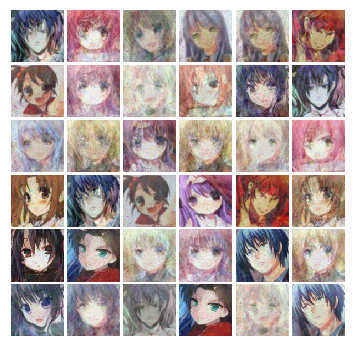


Iter:9000, D:-222.3, G:-45.36
Iter:9005, D:-237.5, G:-55.09
Iter:9010, D:-187.5, G:-53.5
Iter:9015, D:-198.0, G:-44.66
Iter:9020, D:-202.6, G:-50.52
Iter:9025, D:-243.2, G:-50.3
Iter:9030, D:-231.1, G:-55.22
Iter:9035, D:-215.2, G:-22.04
Iter:9040, D:-221.9, G:-56.98
Iter:9045, D:-172.7, G:-38.09
Iter:9050, D:-221.2, G:-59.28
Iter:9055, D:-192.7, G:-41.32
Iter:9060, D:-203.9, G:-64.73
Iter:9065, D:-186.7, G:-24.71
Iter:9070, D:-195.3, G:-50.2
Iter:9075, D:-214.4, G:-41.88
Iter:9080, D:-208.5, G:-20.82
Iter:9085, D:-235.5, G:-61.26
Iter:9090, D:-176.7, G:-47.7
Iter:9095, D:-201.1, G:-37.33
Iter:9100, D:-238.9, G:-48.49
Iter:9105, D:-255.8, G:-46.17
Iter:9110, D:-165.3, G:-27.2
Iter:9115, D:-199.7, G:-49.27
Iter:9120, D:-163.8, G:-25.24
Iter:9125, D:-196.9, G:-40.65
Iter:9130, D:-174.4, G:-55.43
Iter:9135, D:-197.5, G:-59.5
Iter:9140, D:-187.5, G:-45.01
Iter:9145, D:-197.4, G:-39.28
Iter:9150, D:-168.9, G:-24.11
Iter:9155, D:-167.4, G:-45.13
Iter:9160, D:-147.7, G:-15.09
Iter:9165, D:-1

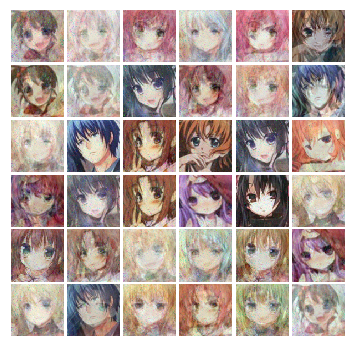


Iter:9200, D:-188.2, G:-42.04
Iter:9205, D:-237.4, G:-66.58
Iter:9210, D:-202.6, G:-52.29
Iter:9215, D:-151.7, G:-41.73
Iter:9220, D:-228.1, G:-75.1
Iter:9225, D:-200.0, G:-48.75
Iter:9230, D:-148.5, G:-25.74
Iter:9235, D:-204.5, G:-45.01
Iter:9240, D:-211.1, G:-48.72
Iter:9245, D:-142.1, G:-25.51
Iter:9250, D:-220.4, G:-51.14
Iter:9255, D:-151.4, G:-46.48
Iter:9260, D:-201.2, G:-44.27
Iter:9265, D:-211.4, G:-42.86
Iter:9270, D:-189.9, G:-52.23
Iter:9275, D:-220.8, G:-67.58
Iter:9280, D:-131.2, G:-31.92
Iter:9285, D:-242.6, G:-65.04
Iter:9290, D:-175.4, G:-63.64
Iter:9295, D:-195.6, G:-55.66
Iter:9300, D:-144.3, G:-31.55
Iter:9305, D:-178.1, G:-51.25
Iter:9310, D:-199.1, G:-32.35
Iter:9315, D:-183.1, G:-47.74
Iter:9320, D:-171.2, G:-25.21
Iter:9325, D:-213.1, G:-35.81
Iter:9330, D:-167.5, G:-51.17
Iter:9335, D:-194.5, G:-39.49
Iter:9340, D:-177.4, G:-63.16
Iter:9345, D:-217.4, G:-59.13
Iter:9350, D:-189.0, G:-42.72
Iter:9355, D:-210.2, G:-55.31
Iter:9360, D:-169.0, G:-42.91
Iter:9365,

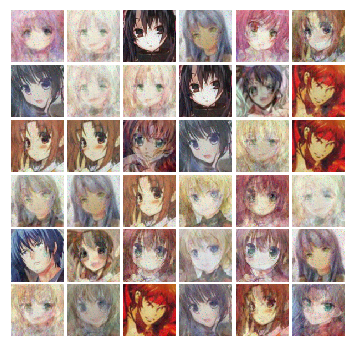


Iter:9400, D:-178.9, G:-62.5
Iter:9405, D:-196.8, G:-62.05
Iter:9410, D:-228.1, G:-54.94
Iter:9415, D:-203.4, G:-36.93
Iter:9420, D:-149.0, G:-47.88
Iter:9425, D:-210.1, G:-46.58
Iter:9430, D:-195.9, G:-43.68
Iter:9435, D:-223.7, G:-46.13
Iter:9440, D:-188.6, G:-57.37
Iter:9445, D:-208.0, G:-59.63
Iter:9450, D:-217.6, G:-43.68
Iter:9455, D:-174.4, G:-57.87
Iter:9460, D:-181.1, G:-55.01
Iter:9465, D:-201.2, G:-32.18
Iter:9470, D:-196.0, G:-45.73
Iter:9475, D:-168.3, G:-66.82
Iter:9480, D:-188.9, G:-57.22
Iter:9485, D:-194.6, G:-68.01
Iter:9490, D:-186.4, G:-42.94
Iter:9495, D:-210.4, G:-37.16
Iter:9500, D:-148.3, G:-28.59
Iter:9505, D:-205.6, G:-37.17
Iter:9510, D:-211.2, G:-44.13
Iter:9515, D:-201.4, G:-58.32
Iter:9520, D:-181.6, G:-32.97
Iter:9525, D:-221.3, G:-54.03
Iter:9530, D:-182.8, G:-42.26
Iter:9535, D:-208.0, G:-46.25
Iter:9540, D:-166.3, G:-46.05
Iter:9545, D:-211.1, G:-42.29
Iter:9550, D:-134.7, G:-37.63
Iter:9555, D:-176.7, G:-46.99
Iter:9560, D:-205.2, G:-36.07
Iter:9565,

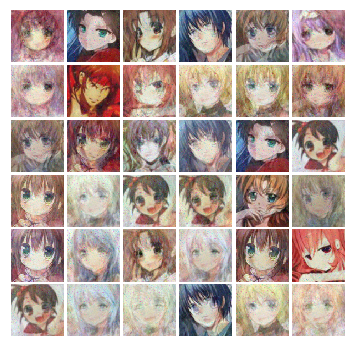


Iter:9600, D:-238.9, G:-61.42
Iter:9605, D:-166.8, G:-44.73
Iter:9610, D:-225.2, G:-61.81
Iter:9615, D:-140.3, G:-49.06
Iter:9620, D:-193.4, G:-47.51
Iter:9625, D:-188.0, G:-58.1
Iter:9630, D:-207.1, G:-60.35
Iter:9635, D:-164.0, G:-47.86
Iter:9640, D:-178.9, G:-63.39
Iter:9645, D:-214.6, G:-39.37
Iter:9650, D:-203.0, G:-72.06
Iter:9655, D:-226.3, G:-59.89
Iter:9660, D:-197.0, G:-46.51
Iter:9665, D:-213.4, G:-49.65
Iter:9670, D:-158.3, G:-56.0
Iter:9675, D:-177.4, G:-58.9
Iter:9680, D:-185.0, G:-52.55
Iter:9685, D:-125.0, G:-35.28
Iter:9690, D:-177.0, G:-62.28
Iter:9695, D:-185.3, G:-49.6
Iter:9700, D:-171.4, G:-37.41
Iter:9705, D:-197.1, G:-56.7
Iter:9710, D:-194.0, G:-68.97
Iter:9715, D:-167.1, G:-52.3
Iter:9720, D:-179.9, G:-55.95
Iter:9725, D:-187.9, G:-42.83
Iter:9730, D:-190.9, G:-43.3
Iter:9735, D:-149.7, G:-20.11
Iter:9740, D:-171.3, G:-42.48
Iter:9745, D:-191.1, G:-51.14
Iter:9750, D:-152.8, G:-49.08
Iter:9755, D:-172.0, G:-38.84
Iter:9760, D:-239.1, G:-66.55
Iter:9765, D:-21

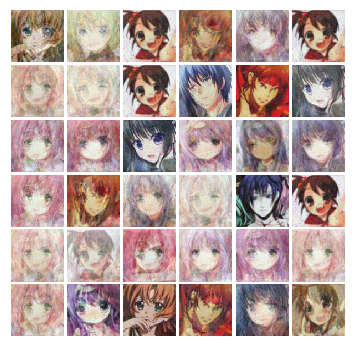


Iter:9800, D:-180.9, G:-48.39
Iter:9805, D:-204.3, G:-74.09
Iter:9810, D:-180.8, G:-47.67
Iter:9815, D:-201.4, G:-52.25
Iter:9820, D:-137.0, G:-30.97
Iter:9825, D:-186.4, G:-39.02
Iter:9830, D:-165.9, G:-48.33
Iter:9835, D:-185.0, G:-50.65
Iter:9840, D:-198.7, G:-54.98
Iter:9845, D:-197.6, G:-42.3
Iter:9850, D:-168.0, G:-35.72
Iter:9855, D:-158.3, G:-32.12
Iter:9860, D:-154.2, G:-38.77
Iter:9865, D:-149.9, G:-42.71
Iter:9870, D:-199.6, G:-57.3
Iter:9875, D:-230.9, G:-62.09
Iter:9880, D:-193.2, G:-55.22
Iter:9885, D:-186.7, G:-41.31
Iter:9890, D:-182.8, G:-47.33
Iter:9895, D:-178.7, G:-51.14
Iter:9900, D:-193.2, G:-49.95
Iter:9905, D:-181.6, G:-38.85
Iter:9910, D:-181.2, G:-38.63
Iter:9915, D:-178.6, G:-41.38
Iter:9920, D:-173.8, G:-46.26
Iter:9925, D:-193.2, G:-35.5
Iter:9930, D:-184.1, G:-36.32
Iter:9935, D:-209.1, G:-31.02
Iter:9940, D:-224.5, G:-51.9
Iter:9945, D:-202.3, G:-46.04
Iter:9950, D:-196.7, G:-34.12
Iter:9955, D:-203.3, G:-74.18
Iter:9960, D:-186.4, G:-52.18
Iter:9965, D:

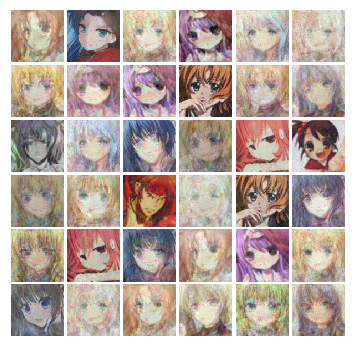


Iter:10000, D:-212.0, G:-30.35
Iter:10005, D:-178.5, G:-34.85
Iter:10010, D:-191.9, G:-41.57
Iter:10015, D:-151.1, G:-41.77
Iter:10020, D:-182.0, G:-44.55
Iter:10025, D:-161.5, G:-58.68
Iter:10030, D:-176.9, G:-49.82
Iter:10035, D:-198.0, G:-48.79
Iter:10040, D:-209.6, G:-56.57
Iter:10045, D:-201.2, G:-41.2
Iter:10050, D:-170.3, G:-47.31
Iter:10055, D:-203.3, G:-48.63
Iter:10060, D:-195.3, G:-31.23
Iter:10065, D:-181.8, G:-51.35
Iter:10070, D:-178.0, G:-39.16
Iter:10075, D:-192.6, G:-57.02
Iter:10080, D:-200.8, G:-47.45
Iter:10085, D:-189.5, G:-41.67
Iter:10090, D:-165.0, G:-22.61
Iter:10095, D:-176.6, G:-37.03
Iter:10100, D:-191.1, G:-52.7
Iter:10105, D:-197.9, G:-39.95
Iter:10110, D:-165.9, G:-37.28
Iter:10115, D:-213.7, G:-69.98
Iter:10120, D:-172.2, G:-38.18
Iter:10125, D:-181.1, G:-42.01
Iter:10130, D:-186.6, G:-45.07
Iter:10135, D:-180.1, G:-28.84
Iter:10140, D:-212.1, G:-47.4
Iter:10145, D:-171.9, G:-54.76
Iter:10150, D:-174.3, G:-47.8
Iter:10155, D:-199.3, G:-37.25
Iter:10160,

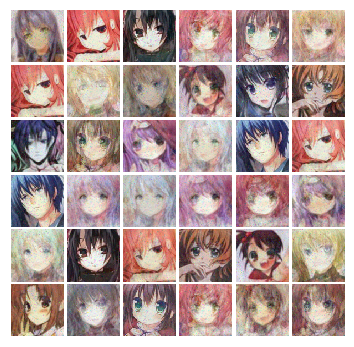


Iter:10200, D:-141.4, G:-54.32
Iter:10205, D:-186.6, G:-46.39
Iter:10210, D:-204.0, G:-60.94
Iter:10215, D:-183.3, G:-57.14
Iter:10220, D:-157.5, G:-25.42
Iter:10225, D:-237.4, G:-57.79
Iter:10230, D:-181.5, G:-43.81
Iter:10235, D:-188.3, G:-47.49
Iter:10240, D:-153.0, G:-49.46
Iter:10245, D:-157.1, G:-49.92
Iter:10250, D:-195.0, G:-50.71
Iter:10255, D:-193.4, G:-72.83
Iter:10260, D:-202.7, G:-56.78
Iter:10265, D:-147.1, G:-43.21
Iter:10270, D:-144.9, G:-33.87
Iter:10275, D:-210.3, G:-43.0
Iter:10280, D:-154.3, G:-50.87
Iter:10285, D:-206.9, G:-52.24
Iter:10290, D:-157.8, G:-38.97
Iter:10295, D:-171.1, G:-47.84
Iter:10300, D:-139.6, G:-31.23
Iter:10305, D:-200.9, G:-53.58
Iter:10310, D:-193.7, G:-57.73
Iter:10315, D:-177.4, G:-47.26
Iter:10320, D:-139.5, G:-38.06
Iter:10325, D:-169.7, G:-43.29
Iter:10330, D:-201.4, G:-68.0
Iter:10335, D:-203.0, G:-47.99
Iter:10340, D:-128.6, G:-47.08
Iter:10345, D:-217.6, G:-30.66
Iter:10350, D:-179.8, G:-58.87
Iter:10355, D:-170.8, G:-48.54
Iter:1036

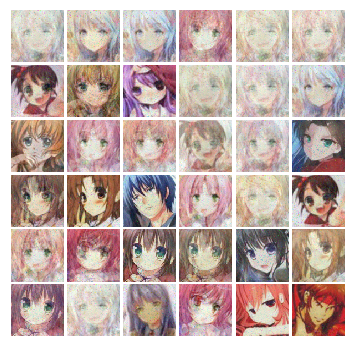


Iter:10400, D:-188.3, G:-54.04
Iter:10405, D:-123.7, G:-24.87
Iter:10410, D:-148.0, G:-40.25
Iter:10415, D:-166.9, G:-38.45
Iter:10420, D:-184.0, G:-43.96
Iter:10425, D:-172.5, G:-57.95
Iter:10430, D:-211.0, G:-65.2
Iter:10435, D:-145.5, G:-11.01
Iter:10440, D:-183.9, G:-63.14
Iter:10445, D:-192.0, G:-60.73
Iter:10450, D:-227.4, G:-62.9
Iter:10455, D:-199.3, G:-57.28
Iter:10460, D:-151.3, G:-39.44
Iter:10465, D:-192.5, G:-47.3
Iter:10470, D:-204.7, G:-45.45
Iter:10475, D:-191.5, G:-52.9
Iter:10480, D:-169.0, G:-49.91
Iter:10485, D:-185.3, G:-45.36
Iter:10490, D:-186.2, G:-55.1
Iter:10495, D:-202.7, G:-56.1
Iter:10500, D:-138.5, G:-28.43
Iter:10505, D:-169.8, G:-53.03
Iter:10510, D:-192.1, G:-49.86
Iter:10515, D:-164.6, G:-43.78
Iter:10520, D:-174.7, G:-67.65
Iter:10525, D:-191.7, G:-40.02
Iter:10530, D:-181.7, G:-38.02
Iter:10535, D:-153.3, G:-47.83
Iter:10540, D:-167.3, G:-56.03
Iter:10545, D:-229.0, G:-65.06
Iter:10550, D:-186.2, G:-61.51
Iter:10555, D:-166.1, G:-36.24
Iter:10560, D

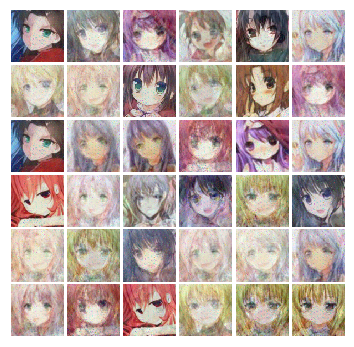


Iter:10600, D:-137.4, G:-50.04
Iter:10605, D:-159.6, G:-43.61
Iter:10610, D:-125.3, G:-34.78
Iter:10615, D:-156.1, G:-42.47
Iter:10620, D:-188.0, G:-44.83
Iter:10625, D:-188.3, G:-27.81
Iter:10630, D:-166.2, G:-43.63
Iter:10635, D:-139.5, G:-47.82
Iter:10640, D:-146.3, G:-31.3
Iter:10645, D:-169.7, G:-34.94
Iter:10650, D:-219.4, G:-67.0
Iter:10655, D:-128.7, G:-28.81
Iter:10660, D:-123.6, G:-37.94
Iter:10665, D:-190.2, G:-58.36
Iter:10670, D:-178.9, G:-52.66
Iter:10675, D:-145.1, G:-38.81
Iter:10680, D:-159.5, G:-49.19
Iter:10685, D:-199.0, G:-45.81
Iter:10690, D:-155.6, G:-36.32
Iter:10695, D:-195.8, G:-46.83
Iter:10700, D:-200.2, G:-51.38
Iter:10705, D:-168.0, G:-55.44
Iter:10710, D:-173.0, G:-44.04
Iter:10715, D:-201.6, G:-54.68
Iter:10720, D:-184.7, G:-59.65
Iter:10725, D:-173.3, G:-51.12
Iter:10730, D:-151.7, G:-26.64
Iter:10735, D:-153.2, G:-37.23
Iter:10740, D:-126.8, G:-46.69
Iter:10745, D:-171.4, G:-49.29
Iter:10750, D:-155.8, G:-45.12
Iter:10755, D:-185.3, G:-53.08
Iter:1076

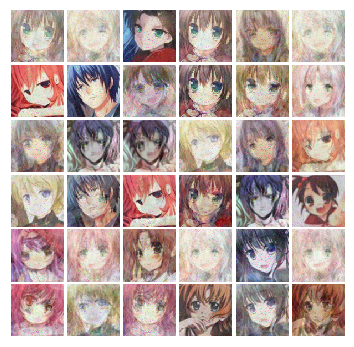


Iter:10800, D:-163.9, G:-60.54
Iter:10805, D:-193.5, G:-47.05
Iter:10810, D:-135.3, G:-45.25
Iter:10815, D:-170.8, G:-59.34
Iter:10820, D:-158.2, G:-37.9
Iter:10825, D:-179.5, G:-73.63
Iter:10830, D:-168.8, G:-46.87
Iter:10835, D:-146.0, G:-43.64
Iter:10840, D:-120.3, G:-27.13
Iter:10845, D:-177.6, G:-51.85
Iter:10850, D:-138.1, G:-37.23
Iter:10855, D:-151.2, G:-35.41
Iter:10860, D:-165.7, G:-60.44
Iter:10865, D:-208.4, G:-43.88
Iter:10870, D:-203.4, G:-52.43
Iter:10875, D:-173.1, G:-60.53
Iter:10880, D:-168.3, G:-52.87
Iter:10885, D:-187.5, G:-41.9
Iter:10890, D:-156.3, G:-34.24
Iter:10895, D:-146.3, G:-47.0
Iter:10900, D:-185.6, G:-46.94
Iter:10905, D:-172.3, G:-54.05
Iter:10910, D:-153.3, G:-35.4
Iter:10915, D:-205.3, G:-49.27
Iter:10920, D:-154.1, G:-48.08
Iter:10925, D:-199.0, G:-44.61
Iter:10930, D:-196.7, G:-70.9
Iter:10935, D:-168.8, G:-41.01
Iter:10940, D:-149.2, G:-46.94
Iter:10945, D:-171.2, G:-52.39
Iter:10950, D:-151.6, G:-44.03
Iter:10955, D:-163.1, G:-56.1
Iter:10960, D

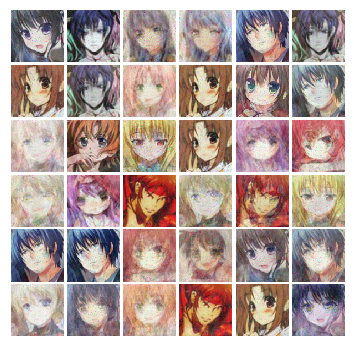


Iter:11000, D:-163.6, G:-85.27
Iter:11005, D:-195.9, G:-68.72
Iter:11010, D:-163.4, G:-48.58
Iter:11015, D:-198.0, G:-47.18
Iter:11020, D:-162.8, G:-43.53
Iter:11025, D:-148.2, G:-66.59
Iter:11030, D:-172.1, G:-43.36
Iter:11035, D:-206.4, G:-52.09
Iter:11040, D:-189.5, G:-69.63
Iter:11045, D:-150.8, G:-54.78
Iter:11050, D:-153.6, G:-41.14
Iter:11055, D:-129.0, G:-49.05
Iter:11060, D:-161.9, G:-48.69
Iter:11065, D:-141.9, G:-57.21
Iter:11070, D:-166.8, G:-67.37
Iter:11075, D:-205.1, G:-71.0
Iter:11080, D:-126.8, G:-50.59
Iter:11085, D:-162.9, G:-55.4
Iter:11090, D:-172.5, G:-60.0
Iter:11095, D:-153.1, G:-32.43
Iter:11100, D:-171.7, G:-43.35
Iter:11105, D:-139.2, G:-47.82
Iter:11110, D:-163.2, G:-63.64
Iter:11115, D:-172.1, G:-64.61
Iter:11120, D:-176.6, G:-66.9
Iter:11125, D:-187.4, G:-59.65
Iter:11130, D:-174.7, G:-45.46
Iter:11135, D:-155.1, G:-63.72
Iter:11140, D:-172.9, G:-53.71
Iter:11145, D:-152.5, G:-68.71
Iter:11150, D:-184.6, G:-61.53
Iter:11155, D:-196.3, G:-54.72
Iter:11160,

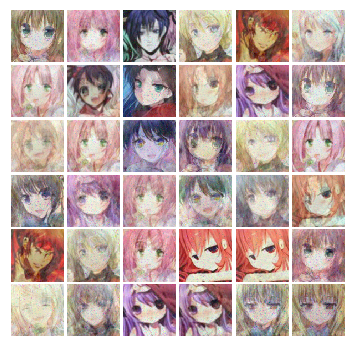


Iter:11200, D:-148.2, G:-67.13
Iter:11205, D:-187.7, G:-43.46
Iter:11210, D:-166.6, G:-45.35
Iter:11215, D:-162.5, G:-42.2
Iter:11220, D:-200.3, G:-48.6
Iter:11225, D:-149.0, G:-65.88
Iter:11230, D:-176.1, G:-64.32
Iter:11235, D:-147.2, G:-69.92
Iter:11240, D:-179.5, G:-49.76
Iter:11245, D:-204.5, G:-57.7
Iter:11250, D:-169.0, G:-57.56
Iter:11255, D:-181.9, G:-58.28
Iter:11260, D:-139.9, G:-43.43
Iter:11265, D:-189.6, G:-52.78
Iter:11270, D:-174.6, G:-56.82
Iter:11275, D:-208.0, G:-47.97
Iter:11280, D:-162.7, G:-48.69
Iter:11285, D:-159.6, G:-57.91
Iter:11290, D:-187.3, G:-28.57
Iter:11295, D:-236.6, G:-75.13
Iter:11300, D:-156.3, G:-50.28
Iter:11305, D:-160.0, G:-44.9
Iter:11310, D:-171.7, G:-37.73
Iter:11315, D:-163.5, G:-42.39
Iter:11320, D:-122.9, G:-42.45
Iter:11325, D:-180.2, G:-47.61
Iter:11330, D:-184.7, G:-51.59
Iter:11335, D:-159.1, G:-31.76
Iter:11340, D:-175.2, G:-45.85
Iter:11345, D:-181.9, G:-36.66
Iter:11350, D:-192.9, G:-69.62
Iter:11355, D:-154.0, G:-66.69
Iter:11360,

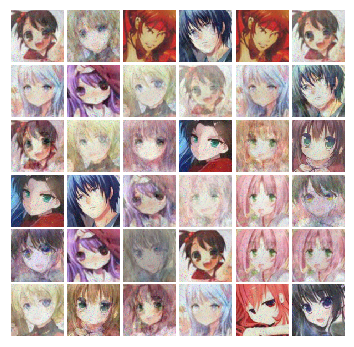


Iter:11400, D:-177.6, G:-83.02
Iter:11405, D:-145.4, G:-44.63
Iter:11410, D:-188.0, G:-39.64
Iter:11415, D:-160.6, G:-47.88
Iter:11420, D:-191.7, G:-54.9
Iter:11425, D:-136.6, G:-50.05
Iter:11430, D:-162.3, G:-29.33
Iter:11435, D:-194.4, G:-61.2
Iter:11440, D:-161.7, G:-65.18
Iter:11445, D:-130.2, G:-75.69
Iter:11450, D:-174.3, G:-36.66
Iter:11455, D:-157.7, G:-51.32
Iter:11460, D:-192.7, G:-62.67
Iter:11465, D:-136.1, G:-55.14
Iter:11470, D:-113.7, G:-42.9
Iter:11475, D:-179.0, G:-57.93
Iter:11480, D:-149.6, G:-57.06
Iter:11485, D:-129.7, G:-52.95
Iter:11490, D:-172.9, G:-55.72
Iter:11495, D:-180.1, G:-51.64
Iter:11500, D:-152.1, G:-68.24
Iter:11505, D:-147.8, G:-52.11
Iter:11510, D:-184.8, G:-66.47
Iter:11515, D:-133.8, G:-32.83
Iter:11520, D:-175.0, G:-62.16
Iter:11525, D:-171.8, G:-46.0
Iter:11530, D:-135.1, G:-35.43
Iter:11535, D:-142.9, G:-39.79
Iter:11540, D:-172.8, G:-58.1
Iter:11545, D:-168.2, G:-70.96
Iter:11550, D:-170.8, G:-42.63
Iter:11555, D:-171.1, G:-53.6
Iter:11560, D

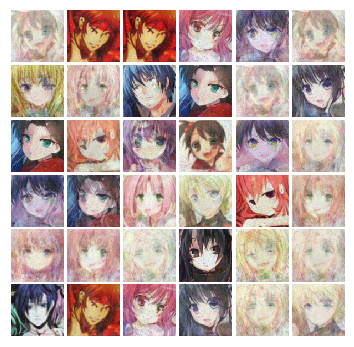


Iter:11600, D:-159.9, G:-43.79
Iter:11605, D:-186.7, G:-58.18
Iter:11610, D:-157.0, G:-63.02
Iter:11615, D:-162.4, G:-36.15
Iter:11620, D:-182.5, G:-64.76
Iter:11625, D:-145.5, G:-34.19
Iter:11630, D:-217.0, G:-78.23
Iter:11635, D:-131.5, G:-53.74
Iter:11640, D:-132.4, G:-59.28
Iter:11645, D:-161.0, G:-47.07
Iter:11650, D:-170.0, G:-67.77
Iter:11655, D:-152.6, G:-46.98
Iter:11660, D:-158.4, G:-29.46
Iter:11665, D:-156.5, G:-52.45
Iter:11670, D:-176.3, G:-76.37
Iter:11675, D:-177.3, G:-39.7
Iter:11680, D:-188.6, G:-61.66
Iter:11685, D:-183.9, G:-91.35
Iter:11690, D:-192.9, G:-62.75
Iter:11695, D:-147.5, G:-45.08
Iter:11700, D:-181.9, G:-62.56
Iter:11705, D:-179.1, G:-63.77
Iter:11710, D:-189.3, G:-54.66
Iter:11715, D:-151.6, G:-72.67
Iter:11720, D:-164.9, G:-49.37
Iter:11725, D:-151.7, G:-52.61
Iter:11730, D:-191.6, G:-71.67
Iter:11735, D:-150.8, G:-44.96
Iter:11740, D:-188.1, G:-57.47
Iter:11745, D:-184.2, G:-60.4
Iter:11750, D:-115.3, G:-41.98
Iter:11755, D:-167.4, G:-62.03
Iter:1176

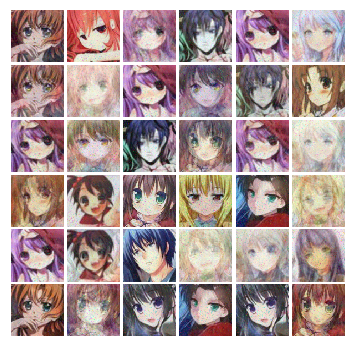


Iter:11800, D:-190.2, G:-37.08
Iter:11805, D:-172.3, G:-60.27
Iter:11810, D:-182.7, G:-68.44
Iter:11815, D:-181.7, G:-56.98
Iter:11820, D:-131.1, G:-61.48
Iter:11825, D:-185.0, G:-59.52
Iter:11830, D:-154.8, G:-33.41
Iter:11835, D:-156.7, G:-67.51
Iter:11840, D:-213.4, G:-41.4
Iter:11845, D:-130.0, G:-23.5
Iter:11850, D:-196.0, G:-57.45
Iter:11855, D:-163.6, G:-54.1
Iter:11860, D:-149.0, G:-35.37
Iter:11865, D:-149.7, G:-45.25
Iter:11870, D:-196.8, G:-68.13
Iter:11875, D:-205.8, G:-73.68
Iter:11880, D:-229.1, G:-79.29
Iter:11885, D:-170.5, G:-49.56
Iter:11890, D:-181.3, G:-41.5
Iter:11895, D:-137.8, G:-46.26
Iter:11900, D:-153.1, G:-67.46
Iter:11905, D:-141.4, G:-27.34
Iter:11910, D:-164.8, G:-40.35
Iter:11915, D:-175.4, G:-64.79
Iter:11920, D:-191.4, G:-70.16
Iter:11925, D:-162.5, G:-45.76
Iter:11930, D:-167.1, G:-52.45
Iter:11935, D:-161.8, G:-47.83
Iter:11940, D:-174.6, G:-50.46
Iter:11945, D:-169.5, G:-61.69
Iter:11950, D:-141.3, G:-33.67
Iter:11955, D:-156.6, G:-43.1
Iter:11960, 

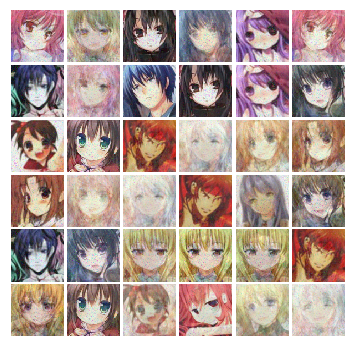


Iter:12000, D:-168.7, G:-39.85
Iter:12005, D:-174.7, G:-62.8
Iter:12010, D:-179.7, G:-55.17
Iter:12015, D:-200.6, G:-58.02
Iter:12020, D:-170.6, G:-39.41
Iter:12025, D:-110.2, G:-19.44
Iter:12030, D:-183.2, G:-63.34
Iter:12035, D:-192.6, G:-62.96
Iter:12040, D:-172.7, G:-47.95
Iter:12045, D:-125.0, G:-46.67
Iter:12050, D:-166.4, G:-46.73
Iter:12055, D:-162.1, G:-41.36
Iter:12060, D:-150.4, G:-47.06
Iter:12065, D:-147.0, G:-48.0
Iter:12070, D:-184.0, G:-55.78
Iter:12075, D:-138.4, G:-38.11
Iter:12080, D:-163.6, G:-41.14
Iter:12085, D:-169.8, G:-32.88
Iter:12090, D:-169.5, G:-46.32
Iter:12095, D:-182.0, G:-53.11
Iter:12100, D:-189.6, G:-51.92
Iter:12105, D:-152.4, G:-41.34
Iter:12110, D:-167.2, G:-39.81
Iter:12115, D:-166.5, G:-40.48
Iter:12120, D:-109.9, G:-53.84
Iter:12125, D:-220.5, G:-70.32
Iter:12130, D:-155.8, G:-51.86
Iter:12135, D:-155.1, G:-57.83
Iter:12140, D:-131.4, G:-53.72
Iter:12145, D:-123.9, G:-40.21
Iter:12150, D:-152.4, G:-40.79
Iter:12155, D:-187.6, G:-37.04
Iter:1216

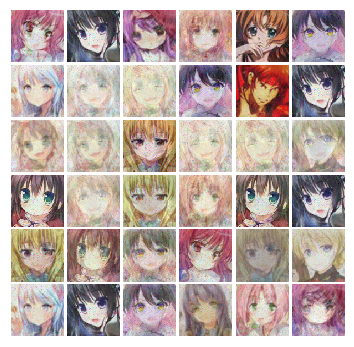


Iter:12200, D:-148.3, G:-32.27
Iter:12205, D:-174.7, G:-61.62
Iter:12210, D:-182.3, G:-32.6
Iter:12215, D:-153.1, G:-52.01
Iter:12220, D:-149.9, G:-55.18
Iter:12225, D:-173.0, G:-44.26
Iter:12230, D:-120.4, G:-16.08
Iter:12235, D:-181.5, G:-88.44
Iter:12240, D:-148.1, G:-41.83
Iter:12245, D:-179.0, G:-54.22
Iter:12250, D:-165.2, G:-69.38
Iter:12255, D:-179.6, G:-66.29
Iter:12260, D:-159.9, G:-53.6
Iter:12265, D:-158.0, G:-59.19
Iter:12270, D:-129.2, G:-37.42
Iter:12275, D:-180.7, G:-46.01
Iter:12280, D:-163.5, G:-54.43
Iter:12285, D:-188.5, G:-59.64
Iter:12290, D:-176.0, G:-88.1
Iter:12295, D:-192.3, G:-77.93
Iter:12300, D:-128.9, G:-50.62
Iter:12305, D:-160.2, G:-57.28
Iter:12310, D:-176.6, G:-64.9
Iter:12315, D:-153.7, G:-60.79
Iter:12320, D:-149.3, G:-39.74
Iter:12325, D:-149.6, G:-42.86
Iter:12330, D:-168.8, G:-40.44
Iter:12335, D:-134.2, G:-50.67
Iter:12340, D:-150.1, G:-48.67
Iter:12345, D:-178.0, G:-48.75
Iter:12350, D:-181.3, G:-32.84
Iter:12355, D:-152.3, G:-19.7
Iter:12360, 

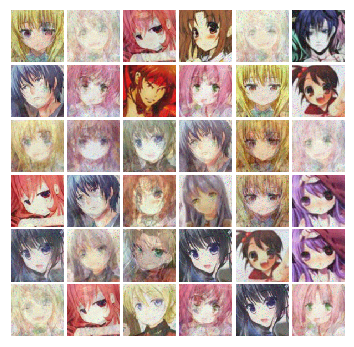


Iter:12400, D:-158.7, G:-65.61
Iter:12405, D:-134.6, G:-49.99
Iter:12410, D:-183.8, G:-66.37
Iter:12415, D:-191.7, G:-44.47
Iter:12420, D:-121.2, G:-33.46
Iter:12425, D:-146.7, G:-44.16
Iter:12430, D:-126.7, G:-29.23
Iter:12435, D:-175.9, G:-49.79
Iter:12440, D:-151.1, G:-51.19
Iter:12445, D:-120.7, G:-24.05
Iter:12450, D:-179.3, G:-55.44
Iter:12455, D:-184.8, G:-47.61
Iter:12460, D:-133.3, G:-32.19
Iter:12465, D:-163.4, G:-63.08
Iter:12470, D:-165.1, G:-67.95
Iter:12475, D:-137.3, G:-41.81
Iter:12480, D:-146.3, G:-47.68
Iter:12485, D:-166.5, G:-61.41
Iter:12490, D:-171.9, G:-51.41
Iter:12495, D:-173.4, G:-39.24
Iter:12500, D:-153.5, G:-53.67
Iter:12505, D:-176.0, G:-55.03
Iter:12510, D:-204.2, G:-68.23
Iter:12515, D:-136.2, G:-45.31
Iter:12520, D:-122.9, G:-49.68
Iter:12525, D:-144.8, G:-53.54
Iter:12530, D:-143.2, G:-51.16
Iter:12535, D:-138.2, G:-48.88
Iter:12540, D:-129.9, G:-70.1
Iter:12545, D:-166.6, G:-81.7
Iter:12550, D:-146.8, G:-51.34
Iter:12555, D:-146.0, G:-53.47
Iter:1256

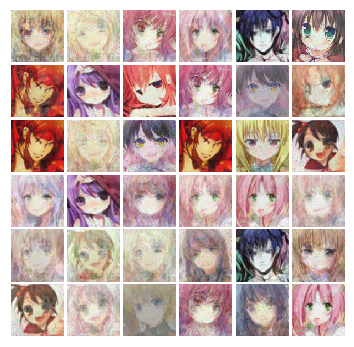


Iter:12600, D:-140.2, G:-26.13
Iter:12605, D:-178.4, G:-50.07
Iter:12610, D:-162.2, G:-71.72
Iter:12615, D:-113.6, G:-36.19
Iter:12620, D:-131.2, G:-36.18
Iter:12625, D:-90.58, G:-41.17
Iter:12630, D:-181.3, G:-56.7
Iter:12635, D:-167.7, G:-53.59
Iter:12640, D:-159.2, G:-64.04
Iter:12645, D:-129.4, G:-40.72
Iter:12650, D:-152.0, G:-49.97
Iter:12655, D:-167.6, G:-56.7
Iter:12660, D:-127.1, G:-43.0
Iter:12665, D:-151.2, G:-36.65
Iter:12670, D:-190.4, G:-66.66
Iter:12675, D:-160.6, G:-61.45
Iter:12680, D:-165.0, G:-54.46
Iter:12685, D:-119.7, G:-33.45
Iter:12690, D:-146.6, G:-51.65
Iter:12695, D:-168.5, G:-63.0
Iter:12700, D:-115.5, G:-30.44
Iter:12705, D:-135.8, G:-52.21
Iter:12710, D:-191.3, G:-45.98
Iter:12715, D:-129.8, G:-30.83
Iter:12720, D:-136.0, G:-30.35
Iter:12725, D:-146.9, G:-50.48
Iter:12730, D:-144.3, G:-45.22
Iter:12735, D:-147.5, G:-37.63
Iter:12740, D:-128.7, G:-40.95
Iter:12745, D:-132.3, G:-39.05
Iter:12750, D:-160.8, G:-66.4
Iter:12755, D:-167.7, G:-47.87
Iter:12760, 

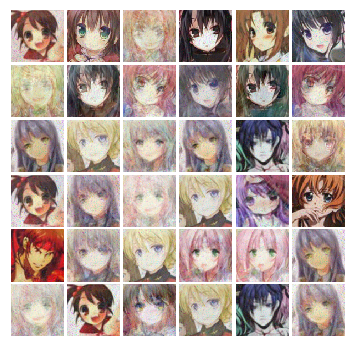


Iter:12800, D:-110.5, G:-50.37
Iter:12805, D:-135.3, G:-63.17
Iter:12810, D:-147.5, G:-49.92
Iter:12815, D:-156.4, G:-44.18
Iter:12820, D:-146.8, G:-37.34
Iter:12825, D:-176.9, G:-53.57
Iter:12830, D:-141.7, G:-32.8
Iter:12835, D:-153.6, G:-41.99
Iter:12840, D:-119.4, G:-35.2
Iter:12845, D:-169.8, G:-58.08
Iter:12850, D:-110.4, G:-39.17
Iter:12855, D:-130.4, G:-47.97
Iter:12860, D:-184.5, G:-63.17
Iter:12865, D:-159.6, G:-56.45
Iter:12870, D:-164.3, G:-71.11
Iter:12875, D:-157.2, G:-79.3
Iter:12880, D:-140.2, G:-39.48
Iter:12885, D:-124.6, G:-34.24
Iter:12890, D:-146.0, G:-49.3
Iter:12895, D:-153.4, G:-40.74
Iter:12900, D:-166.0, G:-39.65
Iter:12905, D:-161.9, G:-46.69
Iter:12910, D:-156.3, G:-55.01
Iter:12915, D:-141.6, G:-60.8
Iter:12920, D:-104.5, G:-44.31
Iter:12925, D:-162.0, G:-44.32
Iter:12930, D:-168.7, G:-42.31
Iter:12935, D:-127.5, G:-47.57
Iter:12940, D:-140.3, G:-44.33
Iter:12945, D:-126.9, G:-52.6
Iter:12950, D:-150.1, G:-43.59
Iter:12955, D:-133.7, G:-49.09
Iter:12960, D

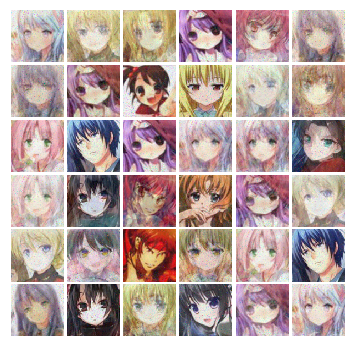


Iter:13000, D:-143.3, G:-43.83
Iter:13005, D:-127.0, G:-20.76
Iter:13010, D:-132.8, G:-30.52
Iter:13015, D:-163.8, G:-57.5
Iter:13020, D:-149.3, G:-46.77
Iter:13025, D:-141.1, G:-58.39
Iter:13030, D:-124.0, G:-47.45
Iter:13035, D:-131.8, G:-49.7
Iter:13040, D:-161.1, G:-52.51
Iter:13045, D:-141.0, G:-43.8
Iter:13050, D:-140.5, G:-35.54
Iter:13055, D:-158.7, G:-36.81
Iter:13060, D:-148.7, G:-31.77
Iter:13065, D:-144.9, G:-33.03
Iter:13070, D:-150.3, G:-32.78
Iter:13075, D:-153.0, G:-41.38
Iter:13080, D:-163.4, G:-51.21
Iter:13085, D:-66.92, G:-21.45
Iter:13090, D:-161.6, G:-51.13
Iter:13095, D:-159.1, G:-60.49
Iter:13100, D:-172.4, G:-45.8
Iter:13105, D:-181.1, G:-48.17
Iter:13110, D:-183.9, G:-29.31
Iter:13115, D:-123.1, G:-21.0
Iter:13120, D:-133.3, G:-31.34
Iter:13125, D:-141.8, G:-26.45
Iter:13130, D:-160.0, G:-64.79
Iter:13135, D:-164.7, G:-49.12
Iter:13140, D:-141.7, G:-50.08
Iter:13145, D:-145.8, G:-35.24
Iter:13150, D:-129.4, G:-45.98
Iter:13155, D:-136.6, G:-51.29
Iter:13160, 

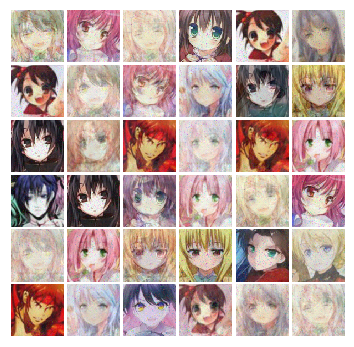


Iter:13200, D:-137.8, G:-41.89
Iter:13205, D:-128.6, G:-28.17
Iter:13210, D:-147.4, G:-46.06
Iter:13215, D:-151.0, G:-48.6
Iter:13220, D:-119.1, G:-29.13
Iter:13225, D:-136.0, G:-13.67
Iter:13230, D:-135.7, G:-31.23
Iter:13235, D:-144.5, G:-42.82
Iter:13240, D:-146.2, G:-41.52
Iter:13245, D:-145.5, G:-37.24
Iter:13250, D:-122.5, G:-48.1
Iter:13255, D:-142.4, G:-42.7
Iter:13260, D:-107.4, G:-30.87
Iter:13265, D:-131.0, G:-43.23
Iter:13270, D:-138.3, G:-49.89
Iter:13275, D:-161.1, G:-41.05
Iter:13280, D:-141.7, G:-50.4
Iter:13285, D:-123.9, G:-54.38
Iter:13290, D:-166.7, G:-44.56
Iter:13295, D:-123.1, G:-45.78
Iter:13300, D:-147.0, G:-46.82
Iter:13305, D:-149.4, G:-41.47
Iter:13310, D:-133.6, G:-33.94
Iter:13315, D:-125.8, G:-46.99
Iter:13320, D:-130.2, G:-40.75
Iter:13325, D:-138.4, G:-37.8
Iter:13330, D:-165.8, G:-59.95
Iter:13335, D:-158.9, G:-45.14
Iter:13340, D:-119.3, G:-36.85
Iter:13345, D:-172.0, G:-66.05
Iter:13350, D:-147.2, G:-46.99
Iter:13355, D:-138.4, G:-49.4
Iter:13360, D

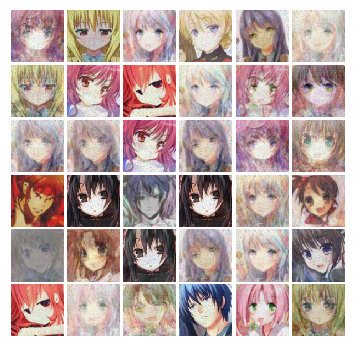


Iter:13400, D:-128.6, G:-25.42
Iter:13405, D:-134.4, G:-35.13
Iter:13410, D:-128.3, G:-21.44
Iter:13415, D:-147.4, G:-32.05
Iter:13420, D:-162.7, G:-40.76
Iter:13425, D:-135.2, G:-47.32
Iter:13430, D:-155.0, G:-30.69
Iter:13435, D:-115.3, G:-27.85
Iter:13440, D:-145.0, G:-61.04
Iter:13445, D:-146.5, G:-50.32
Iter:13450, D:-136.0, G:-41.93
Iter:13455, D:-108.2, G:-32.56
Iter:13460, D:-135.6, G:-33.26
Iter:13465, D:-141.8, G:-14.95
Iter:13470, D:-155.5, G:-31.1
Iter:13475, D:-140.6, G:-38.76
Iter:13480, D:-152.4, G:-60.54
Iter:13485, D:-169.2, G:-46.29
Iter:13490, D:-137.7, G:-42.18
Iter:13495, D:-156.7, G:-38.68
Iter:13500, D:-142.0, G:-38.58
Iter:13505, D:-120.9, G:-48.6
Iter:13510, D:-124.2, G:-32.26
Iter:13515, D:-150.7, G:-68.54
Iter:13520, D:-165.4, G:-52.63
Iter:13525, D:-117.0, G:-40.11
Iter:13530, D:-149.0, G:-22.28
Iter:13535, D:-153.0, G:-49.32
Iter:13540, D:-111.5, G:-28.82
Iter:13545, D:-140.7, G:-40.15
Iter:13550, D:-147.3, G:-45.46
Iter:13555, D:-140.1, G:-63.33
Iter:1356

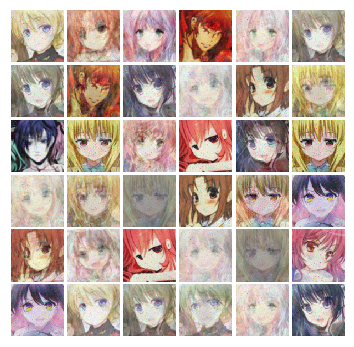


Iter:13600, D:-125.7, G:-39.88
Iter:13605, D:-144.5, G:-44.52
Iter:13610, D:-143.4, G:-51.32
Iter:13615, D:-116.7, G:-38.17
Iter:13620, D:-101.9, G:-46.82
Iter:13625, D:-143.6, G:-50.47
Iter:13630, D:-134.9, G:-45.67
Iter:13635, D:-146.0, G:-52.55
Iter:13640, D:-140.6, G:-67.37
Iter:13645, D:-133.5, G:-51.28
Iter:13650, D:-151.0, G:-38.85
Iter:13655, D:-137.8, G:-38.05
Iter:13660, D:-157.1, G:-55.27
Iter:13665, D:-157.0, G:-49.46
Iter:13670, D:-135.2, G:-52.59
Iter:13675, D:-111.1, G:-5.855
Iter:13680, D:-136.5, G:-32.94
Iter:13685, D:-143.2, G:-54.51
Iter:13690, D:-154.4, G:-47.83
Iter:13695, D:-126.7, G:-59.51
Iter:13700, D:-118.5, G:-34.5
Iter:13705, D:-126.4, G:-34.84
Iter:13710, D:-141.4, G:-27.93
Iter:13715, D:-126.6, G:-33.14
Iter:13720, D:-151.8, G:-43.28
Iter:13725, D:-131.7, G:-39.72
Iter:13730, D:-105.8, G:-43.96
Iter:13735, D:-124.9, G:-48.48
Iter:13740, D:-94.72, G:-39.33
Iter:13745, D:-137.6, G:-47.88
Iter:13750, D:-160.8, G:-60.69
Iter:13755, D:-147.4, G:-49.42
Iter:137

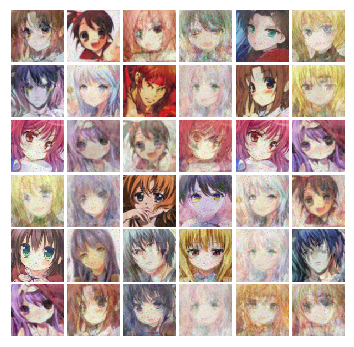


Iter:13800, D:-128.3, G:-44.21
Iter:13805, D:-152.1, G:-46.35
Iter:13810, D:-150.1, G:-52.17
Iter:13815, D:-161.9, G:-47.0
Iter:13820, D:-158.4, G:-57.55
Iter:13825, D:-107.2, G:-23.13
Iter:13830, D:-150.8, G:-64.4
Iter:13835, D:-130.4, G:-47.64
Iter:13840, D:-130.6, G:-41.4
Iter:13845, D:-139.4, G:-46.7
Iter:13850, D:-117.0, G:-42.93
Iter:13855, D:-155.9, G:-51.22
Iter:13860, D:-111.6, G:-52.15
Iter:13865, D:-149.7, G:-54.58
Iter:13870, D:-133.0, G:-44.71
Iter:13875, D:-88.71, G:-37.85
Iter:13880, D:-116.8, G:-35.72
Iter:13885, D:-147.3, G:-46.13
Final images


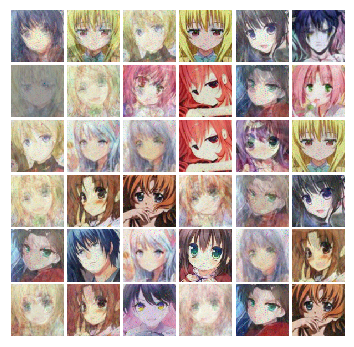

In [23]:
tf.reset_default_graph()
img_size = cifar_10.shape[1]
x = tf.placeholder(tf.float32,[batch_size,img_size*img_size*3])#----------------------------------------change para
img_real = x
z = sample_noise(batch_size,noise_dim) 
G_sample = generator(z)#output [batch,96*96*3]

out_img = tf.reshape(deprocess(G_sample[:save_size]),[-1,img_size,img_size,3])#------------------------change para  #resize shape. 9696

                                                        #output = [batch,96,96,3] 

with tf.variable_scope("") as scope:
    logits_real = discriminator(preprocess(x))
    scope.reuse_variables()
    logits_fake = discriminator(G_sample)
    
D_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,'discriminator')
G_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,'generator')
d_solver,g_solver = get_solvers()

d_loss,g_loss = wgan_gp_loss(logits_real,logits_fake,batch_size,x,G_sample) #change loss oneonoeneone ----------------
d_train_step = d_solver.minimize(d_loss,var_list=D_vars)
g_train_step = g_solver.minimize(g_loss,var_list=G_vars)
d_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS,'discriminator')
g_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS,'generator')
tf.summary.image("image",out_img,max_outputs=save_size)
merged = tf.summary.merge_all()

with session() as sess:
    try:
        with tf.device("/gpu:0") as dev:
            #merged
            
            ##initialize
            sess.run(tf.global_variables_initializer())
            
            
            train_writer = tf.summary.FileWriter(log_dir,sess.graph)
            
            train(sess,g_train_step,g_loss,d_train_step,d_loss,g_extra_step,d_extra_step,
                  show_every=200,print_every=5,batch_size=batch_size,num_epoch=5000)    
    except tf.errors.InvalidArgumentError:
        print("no gpu found, please use Google Cloud if you want GPU acceleration") 
